In [16]:
import healpy as hp
import numpy as np
import matplotlib.pyplot as plt
import camb
from camb import model, initialpower
import os
from scipy.special import eval_legendre

## Theoretical power spectrum from CAMB

In [17]:
nside = 512            # HEALPix resolution
lmax = 3 * nside       # Maximum multipole to compute
npix = hp.nside2npix(nside)  # Number of pixels

In [18]:
np.random.seed(36) # 0, 36

### CAMB Parameters and result:

In [19]:
pars = camb.CAMBparams()
# Set your cosmological parameters (example values)
pars.set_cosmology(H0=67.32, ombh2=0.022383, omch2=0.12011)
pars.InitPower.set_params(As=2.1002e-9, ns=0.96605)
pars.set_for_lmax(lmax, lens_potential_accuracy=0)

results = camb.get_results(pars)
powers = results.get_cmb_power_spectra(pars, CMB_unit='muK')

cl_d_l = powers['total'][:, 0]  # This is D_l = l(l+1)C_l/(2π)

ell = np.arange(cl_d_l.shape[0])
cl_tt = np.zeros_like(cl_d_l)

# Convert D_l to C_l
cl_tt[2:] = cl_d_l[2:] * (2 * np.pi) / (ell[2:] * (ell[2:] + 1))
cl_tt[0] = 0  # Typically set to zero
cl_tt[1] = 0

print(f"cl_tt shape: {cl_tt.shape}, ell_max: {ell[-1]}")

cl_tt shape: (1551,), ell_max: 1550


<Figure size 700x400 with 0 Axes>

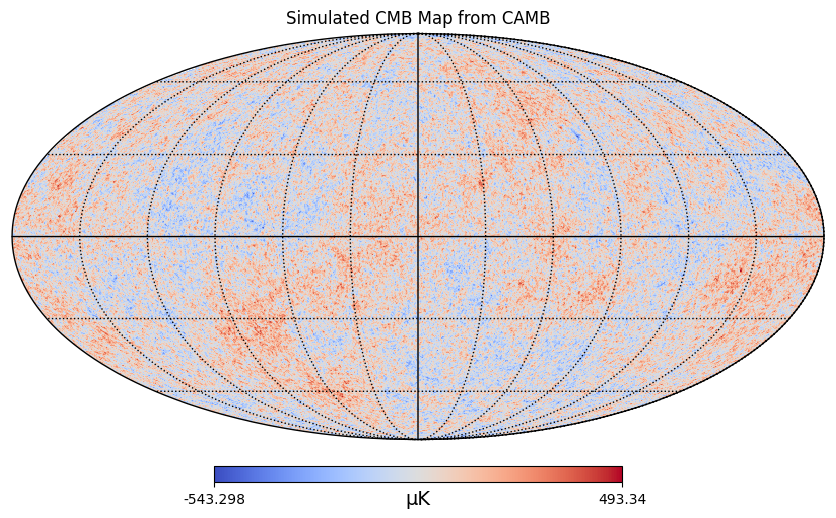

In [ ]:
# Generate a random realization of the CMB sky from theoretical Cl
cmb_map = hp.synfast(cl_tt, nside=nside, lmax=lmax, new=True)

# Plot the map
plt.figure(figsize=(7,4))
hp.mollview(cmb_map, title="Simulated CMB Map from CAMB", cmap="coolwarm", unit="μK")
hp.graticule()

plt.savefig("output/CMB_map_CAMB.png", dpi = 300)
plt.show()

# cl_CMB = hp.anafast(cmb_map, lmax = len(ell)-1)
plt.figure(figsize=(7,4))
# plt.plot(ell, 1 / (2 * np.pi) * cl_CMB * (ell * (ell + 1)), label=r'TT Power Spectrum $C_\ell^{TT}$')
plt.plot(ell, cl_d_l, label=r'TT Power Spectrum $C_\ell^{TT}$')

plt.xlabel(r'Multipole $\ell$')
plt.ylabel(r'$ \frac{\ell (\ell +1)}{2\pi}  C_\ell^{TT}$ [$\mu K^2$]')
plt.title('CMB Temperature Power Spectrum from CAMB')
plt.xlim(2, lmax)
# plt.yscale('log')
plt.grid(True, which='both', ls='--', alpha=0.5)
plt.legend()
plt.show()

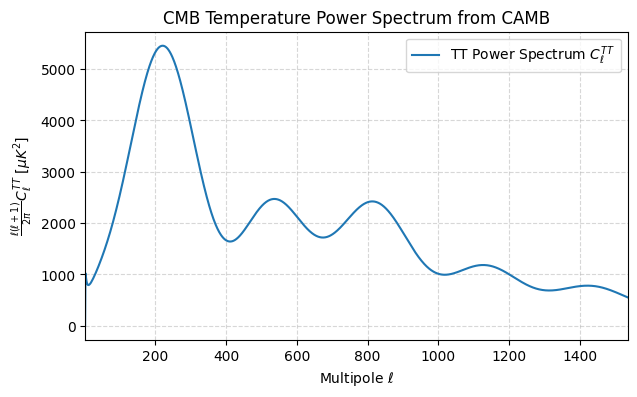

## nSI map generator Function


In [ ]:
def get_nSI_Map(o_map, A,p, nside, f= "cos"):
    """
    Function to generate a non-Gaussian CMB map with nSI signal
    Parameters:
    o_map: Original CMB map
    A: Modulation factor
    p: Special Direction
    nside: HEALPix resolution parameter (default=512)
    f: Function to generate anisotropy
    Returns:
    nSI_map: CMB map with nSI signal
    """
    nside = hp.get_nside(o_map)
    npix = hp.nside2npix(nside)
    

    if f == "cos":
        vecs = np.array(hp.pix2vec(nside, np.arange(npix))) # Get pixel coordinates
        dot_prod = np.einsum('i,ij->j', p, vecs)/np.linalg.norm(p) # Compute dot product
        F = dot_prod
    elif f == "sin":
        vecs = np.array(hp.pix2vec(nside, np.arange(npix))) # Get pixel coordinates
        dot_prod = np.einsum('i,ij->j', p, vecs)/np.linalg.norm(p) # Compute dot product
        F = np.sqrt(1 - dot_prod**2)
    else:
        theta_all, phi_all = hp.pix2ang(nside, np.arange(hp.nside2npix(nside))) # Get pixel angles
        if p == [0,0,1]:
            F = f(theta_all, phi_all)
        else:
            F = f(theta_all, phi_all)
            "Define the Reverse rotation to get the F rotated such that F features are defined around Direction P. So Z-axis -> P"
            thetap, phip = hp.vec2ang(np.array(p))
            # print(p, thetap, phip)
            if phip <= np.pi:
                Phi = np.arctan(-1/np.tan(phip[0])) + np.pi 
            else:
                Phi = np.arctan(-1/np.tan(phip[0]))

            # Now calculate the Euler angles:
            alpha = -Phi + np.pi/2
            beta = thetap[0]
            gamma = 0 #-alpha
            # print(Phi, alpha, beta, gamma)

            Reverse_Rotation1 = hp.rotator.Rotator( rot = [0, beta, 0], deg =False)
            Reverse_Rotation2 = hp.rotator.Rotator( rot = [alpha, 0, 0], deg =False)

            F = Reverse_Rotation2.rotate_map_pixel(Reverse_Rotation1.rotate_map_pixel(F))

    nSI_map = o_map*(1 + A*F)    
    return nSI_map


### --- For A = 1 \& $  F = \cos(\theta)$   
### --- For A = 0.5 \& $  F = \cos(\theta)$   


setting the output map dtype to [dtype('float64')]


Map saved successfully as nSI_CMB_map_cos_theta.fits


<Figure size 700x400 with 0 Axes>

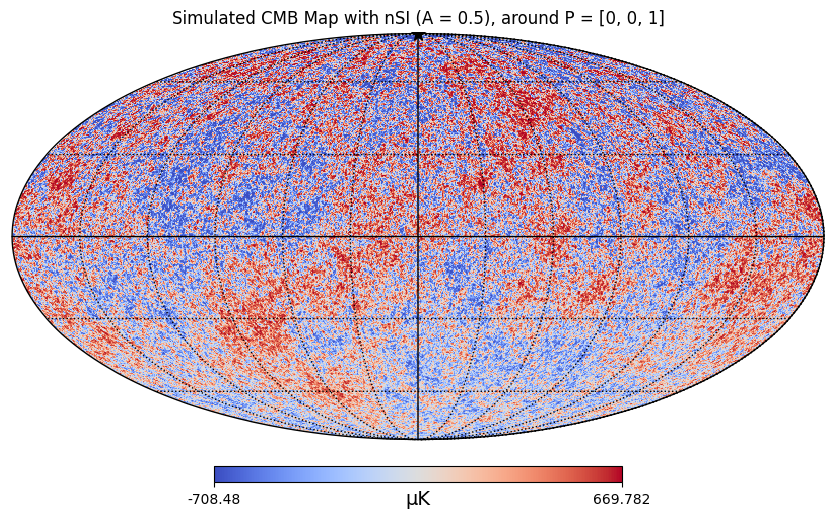

<Figure size 700x400 with 0 Axes>

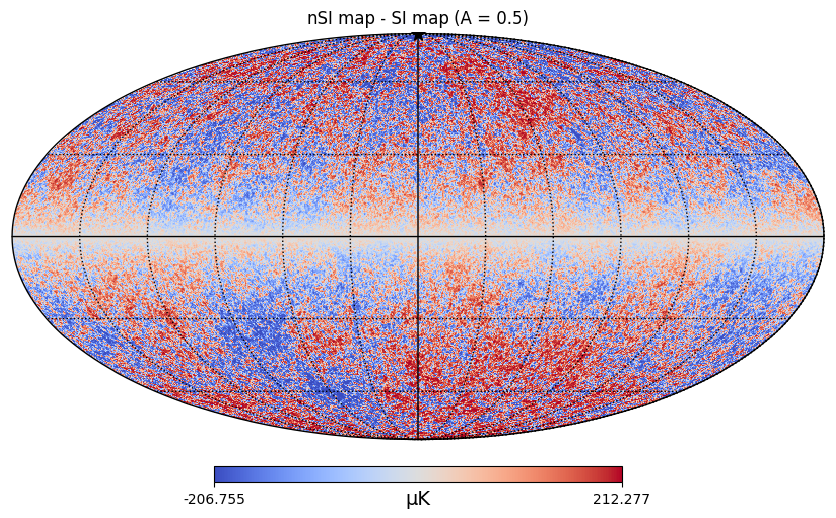

In [50]:
P = [0, 0, 1]
A = 0.5
theta_p , phi_p = hp.vec2ang(np.array(P))
theta_p, phi_p = theta_p[0], phi_p[0]
nSI_CMB_map = get_nSI_Map(cmb_map, A, P, nside, f="cos")

# Define the output filename
output_filename = "nSI_CMB_map_cos_theta.fits"
hp.write_map(output_filename, nSI_CMB_map, overwrite=True)
print(f"Map saved successfully as {output_filename}")

plt.figure(figsize=(7,4))
hp.mollview(nSI_CMB_map, title=f"Simulated CMB Map with nSI (A = {A}), around P = {P}", cmap="coolwarm", unit="μK", norm="hist")
hp.projscatter(theta_p, phi_p, s=100, c='black', marker='*')
hp.graticule()
plt.show()

plt.figure(figsize=(7,4))
hp.mollview(nSI_CMB_map-cmb_map, title=f"nSI map - SI map (A = {A})", cmap="coolwarm", unit="μK", norm="hist")
hp.projscatter(theta_p, phi_p, s=100, c='black', marker='*')
hp.graticule()
plt.show()

# plt.figure(figsize=(7,4))
# hp.mollview(nSI_CMB_map-nSI_CMB_map.min(), title="Simulated CMB Map with nSI", cmap="coolwarm", unit="μK", norm="log")
# hp.graticule()
# plt.show()

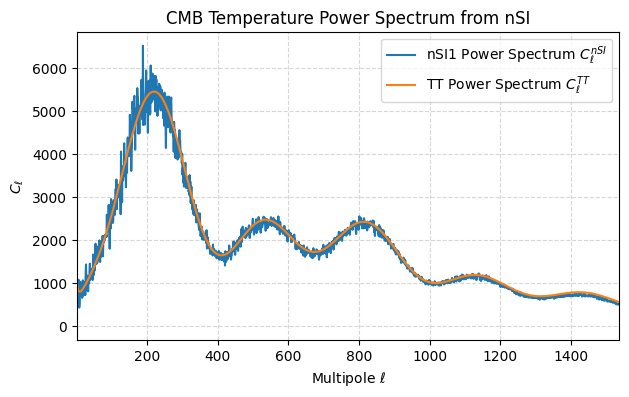

In [51]:
# extract c_l form the nSI_map

cl_nSI = hp.anafast(nSI_CMB_map, lmax=lmax)
ell2= np.arange(cl_nSI.shape[0])

plt.figure(figsize=(7,4))
plt.plot(ell2,1 / (2 * np.pi) * cl_nSI* (ell2* (ell2+ 1))/1.1, label=r'nSI1 Power Spectrum $C_\ell^{nSI}$')
plt.plot(ell, 1 / (2 * np.pi) * cl_tt * (ell * (ell + 1)), label=r'TT Power Spectrum $C_\ell^{TT}$')

# plt.plot(ell, cl_tt, label=r'SI Power Spectrum $C_\ell^{TT}$')
plt.xlabel(r'Multipole $\ell$')
plt.ylabel(r'$C_\ell$')
plt.title('CMB Temperature Power Spectrum from nSI')
plt.xlim(2, lmax)
# plt.yscale('log')
plt.grid(True, which='both', ls='--', alpha=0.5)
plt.legend()
plt.show()

- The $C_l$ do not match exactly.
- The $C_l^{nSI}$ has to be divide by some arbitrary number ~ $1.33$   , for A = 1, to match it to $C_l ^{SI}$
- The $C_l^{nSI}$ has to be divide by some arbitrary number ~ $1.1$   , for A = 0.5, to match it to $C_l ^{SI}$


### For A = 5  \& $  F = \cos(\theta)$   
### For A = 0.5  \& $  F = \cos(\theta)$   


<Figure size 700x400 with 0 Axes>

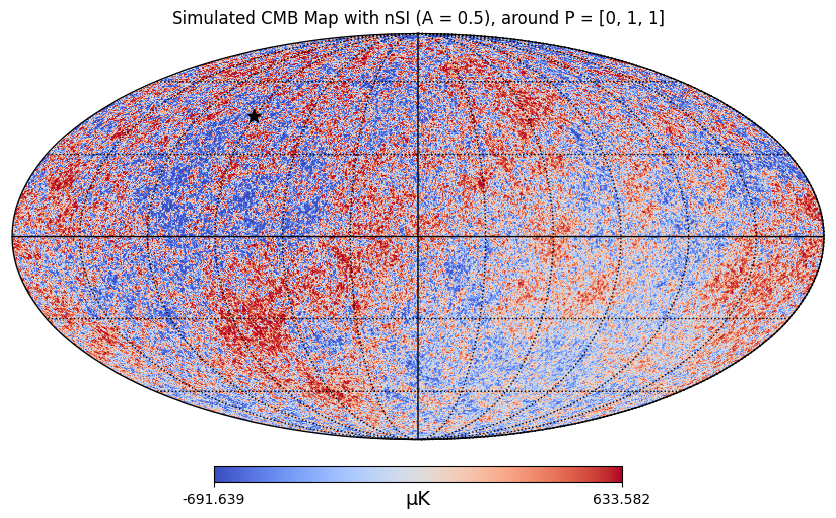

<Figure size 700x400 with 0 Axes>

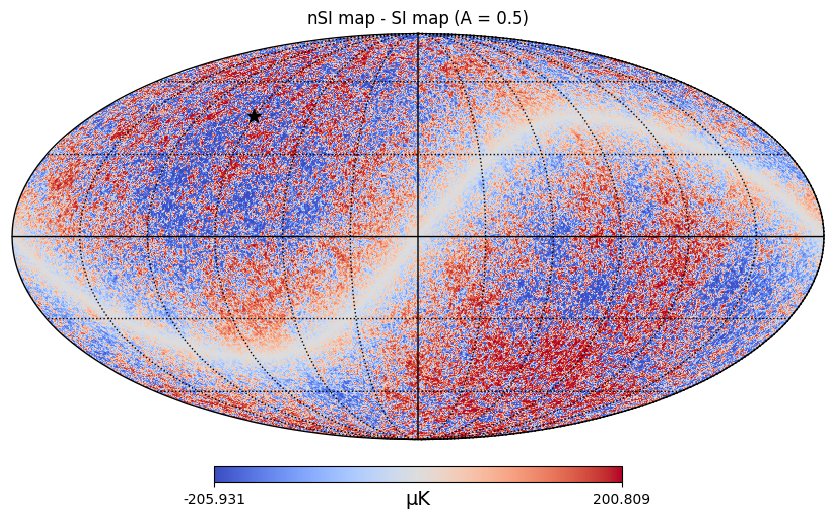

In [52]:
P = [0, 1, 1]
A = 0.5
theta_p , phi_p = hp.vec2ang(np.array(P))
theta_p, phi_p = theta_p[0], phi_p[0]
nSI_CMB_map2 = get_nSI_Map(cmb_map, A, P, nside, f="cos")

plt.figure(figsize=(7,4))
hp.mollview(nSI_CMB_map2, title=f"Simulated CMB Map with nSI (A = {A}), around P = {P}", cmap="coolwarm", unit="μK", norm="hist")
hp.projscatter(theta_p, phi_p, s=100, c='black', marker='*')
hp.graticule()
plt.show()

plt.figure(figsize=(7,4))
hp.mollview(nSI_CMB_map2-cmb_map, title=f"nSI map - SI map (A = {A})", cmap="coolwarm", unit="μK", norm="hist")
hp.projscatter(theta_p, phi_p, s=100, c='black', marker='*')
hp.graticule()
plt.show()

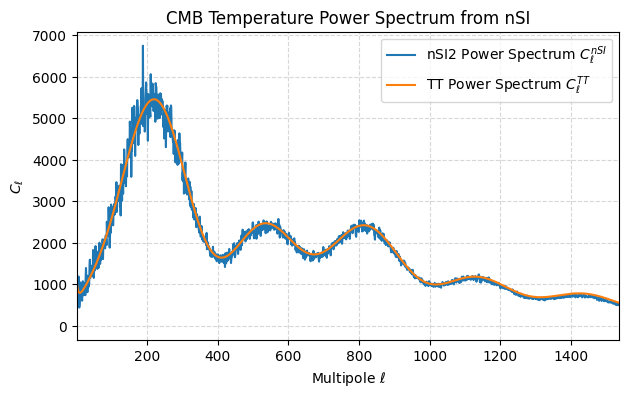

In [53]:

# extract c_l form the nSI_map

cl_nSI2 = hp.anafast(nSI_CMB_map2, lmax=lmax)
# ell2= np.arange(cl_nSI.shape[0])

plt.figure(figsize=(7,4))
plt.plot(ell2,1 / (2 * np.pi) * cl_nSI2* (ell2* (ell2+ 1))/1.1, label=r'nSI2 Power Spectrum $C_\ell^{nSI}$')
plt.plot(ell, 1 / (2 * np.pi) * cl_tt * (ell * (ell + 1)), label=r'TT Power Spectrum $C_\ell^{TT}$')

# plt.plot(ell, cl_tt, label=r'SI Power Spectrum $C_\ell^{TT}$')
plt.xlabel(r'Multipole $\ell$')
plt.ylabel(r'$C_\ell$')
plt.title('CMB Temperature Power Spectrum from nSI')
plt.xlim(2, lmax)
# plt.yscale('log')
plt.grid(True, which='both', ls='--', alpha=0.5)
plt.legend()
plt.show()

- The $C_l$ do not match exactly.
- The $C_l^{nSI}$ has to be divide by some arbitrary number ~ $9.4$ , for A = 5, to match it to $C_l ^{SI}$
- The $C_l^{nSI}$ has to be divide by some arbitrary number ~ $1.1$ , for A = 0.5, to match it to $C_l ^{SI}$

- The $C_l^{nSI}$ has to be divide by the arbitrary number ~ $9.4$ , for A = 5, P = [1, 1, 0] & [1, 1, 1] & [1, 2, 3], to match it to $C_l ^{SI}$, normalised by |P|


### For A = 1  \& $  F = \cos(5\theta)$   
### For A = 0.5  \& $  F = \cos(\varphi)$   

In [54]:
def theta_function(theta, phi):
    F = np.cos(2*theta)
    return F

In [55]:
def phi_function(theta, phi):
    F = np.cos(phi)
    return F

setting the output map dtype to [dtype('float64')]


Map saved successfully as nSI_CMB_map_cos_phi.fits


<Figure size 700x400 with 0 Axes>

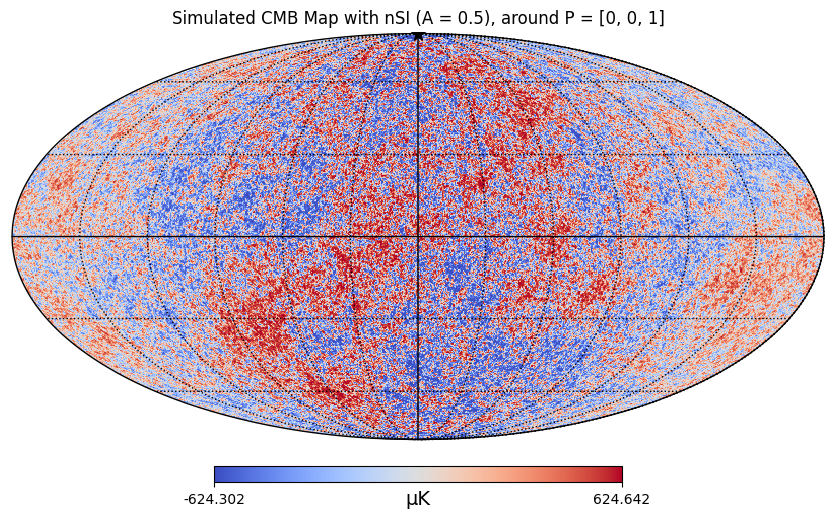

<Figure size 700x400 with 0 Axes>

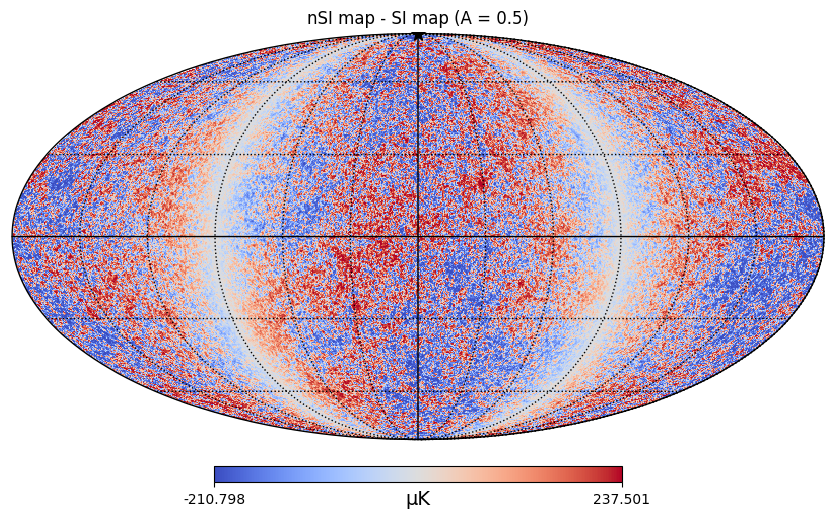

In [56]:
P = [0, 0, 1]
A = 0.5
theta_p , phi_p = hp.vec2ang(np.array(P))
theta_p, phi_p = theta_p[0], phi_p[0]
nSI_CMB_map3 = get_nSI_Map(cmb_map, A, P, nside, f=phi_function)

output_filename = "nSI_CMB_map_cos_phi.fits"
hp.write_map(output_filename, nSI_CMB_map3, overwrite=True)
print(f"Map saved successfully as {output_filename}")

plt.figure(figsize=(7,4))
hp.mollview(nSI_CMB_map3, title=f"Simulated CMB Map with nSI (A = {A}), around P = {P}", cmap="coolwarm", unit="μK", norm="hist")
hp.projscatter(theta_p, phi_p, s=100, c='black', marker='*')
hp.graticule()
plt.show()

plt.figure(figsize=(7,4))
hp.mollview(nSI_CMB_map3-cmb_map, title=f"nSI map - SI map (A = {A})", cmap="coolwarm", unit="μK", norm="hist")
hp.projscatter(theta_p, phi_p, s=100, c='black', marker='*')
hp.graticule()
plt.show()

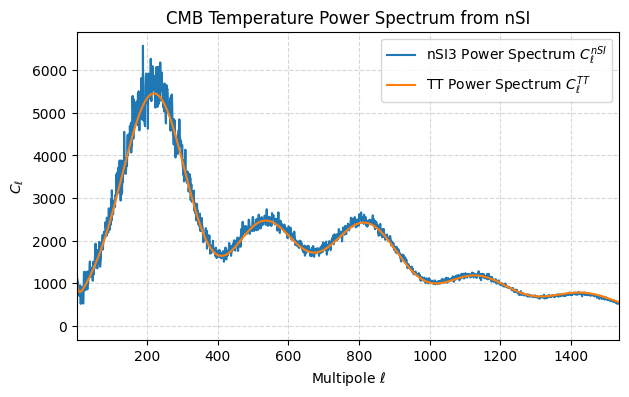

In [ ]:
# extract c_l form the nSI_map

cl_nSI3 = hp.anafast(nSI_CMB_map3, lmax=lmax)
# ell2= np.arange(cl_nSI.shape[0])

plt.figure(figsize=(7,4))
plt.plot(ell2,1 / (2 * np.pi) * cl_nSI3* (ell2* (ell2+ 1))/1.1, label=r'nSI3 Power Spectrum $C_\ell^{nSI}$')
plt.plot(ell, 1 / (2 * np.pi) * cl_tt * (ell * (ell + 1)), label=r'TT Power Spectrum $C_\ell^{TT}$')

# plt.plot(ell, cl_tt, label=r'SI Power Spectrum $C_\ell^{TT}$')
plt.xlabel(r'Multipole $\ell$')
plt.ylabel(r'$C_\ell$')
plt.title('CMB Temperature Power Spectrum from nSI')
plt.xlim(2, lmax)
# plt.yscale('log')
plt.grid(True, which='both', ls='--', alpha=0.5)
plt.legend()
plt.show()

### For A = 1  \& $  F = \cos(5\varphi)$   
### For A = 0.5  \& $  F = \cos(\varphi)$   


<Figure size 700x400 with 0 Axes>

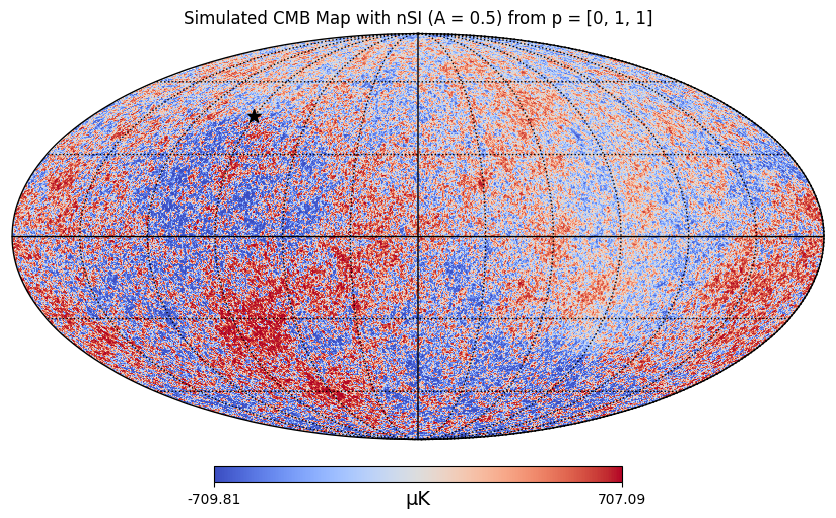

<Figure size 700x400 with 0 Axes>

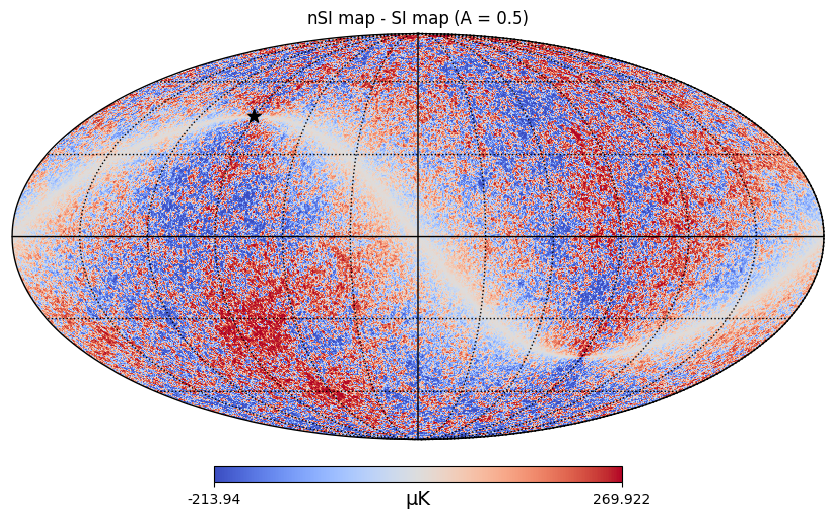

In [58]:
P = [0, 1, 1]
A = 0.5
theta_p , phi_p = hp.vec2ang(np.array(P))
theta_p, phi_p = theta_p[0], phi_p[0]
nSI_CMB_map4 = get_nSI_Map(cmb_map, A, P, nside, f=phi_function)

plt.figure(figsize=(7,4))
hp.mollview(nSI_CMB_map4, title=f"Simulated CMB Map with nSI (A = {A}) from p = {P}", cmap="coolwarm", unit="μK", norm="hist")
hp.projscatter(theta_p, phi_p, marker='*', color='black', s=100)
hp.graticule()
plt.show()

plt.figure(figsize=(7,4))
hp.mollview(nSI_CMB_map4-cmb_map, title=f"nSI map - SI map (A = {A})", cmap="coolwarm", unit="μK", norm="hist")
hp.projscatter(theta_p, phi_p, marker='*', color='black', s=100)
hp.graticule()
plt.show()

## Planck SMICA Foreground cleaned Map

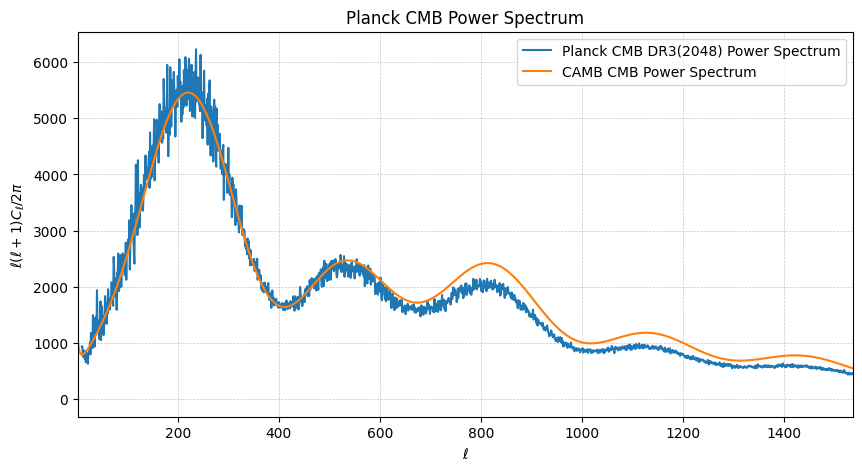

In [22]:
# Path to the FITS file
cl_planck = hp.read_cl("cl_planck.fits")  # Values are in K^2
ell_planck = np.arange(len(cl_planck))

plt.figure(figsize=(10, 5))
plt.plot(ell_planck[10:-1], (ell_planck * (ell_planck + 1) * cl_planck/ (2 * np.pi))[10:-1], label="Planck CMB DR3(2048) Power Spectrum")
plt.plot(ell, cl_d_l, label="CAMB CMB Power Spectrum")
plt.title("Planck CMB Power Spectrum")
plt.xlabel("$\ell$")
plt.ylabel("$\ell(\ell+1)C_{\ell} / 2\pi $")
# plt.yscale("log")
plt.xlim(2, lmax)
plt.grid(which='both', linestyle='--', linewidth=0.5, alpha=0.7)
plt.legend()
plt.savefig("output/C_l_CAMB.png", dpi=300)
plt.show()



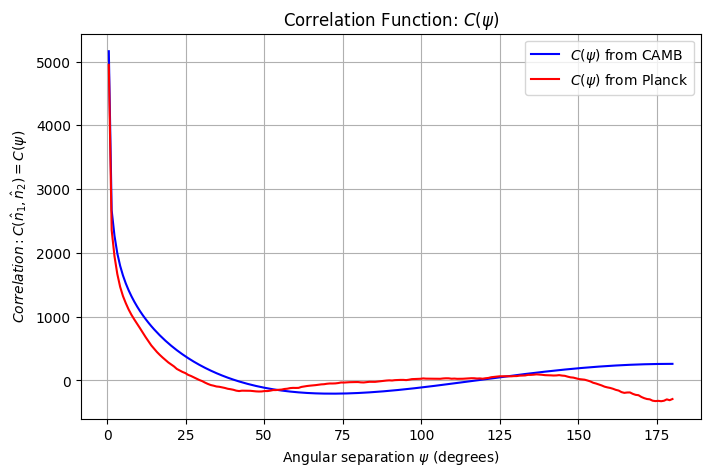

In [23]:
# ---- Compute C(theta) ----
psi = np.linspace(0.01, np.pi, 200)  # Angular separation from 0 to π
c_psi = np.zeros_like(psi)
c_psi_planck = np.zeros_like(psi)   # Planck C(psi)

for i, t in enumerate(psi):
    # print(i, t)
    legendre_vals = eval_legendre(ell, np.cos(t))  # P_l(cosθ)
    # print(legendre_vals[0:2])
    c_psi[i] = np.sum((2 * ell+ 1) / (4 * np.pi) * cl_tt * legendre_vals)  # Sum over ell
    legendre_vals = eval_legendre(ell_planck, np.cos(t)) 
    c_psi_planck[i] = np.sum((2 * ell_planck+ 1) / (4 * np.pi) * cl_planck * legendre_vals)  # Sum over ell
    # print(i, t,c_psi[i])

# ---- Plot C(psi) ----
plt.figure(figsize=(8, 5))
plt.plot(np.degrees(psi), c_psi, color='b', label=r'$C(\psi)$ from CAMB')
plt.plot(np.degrees(psi), c_psi_planck, color='r', label=r'$C(\psi)$ from Planck')
plt.xlabel(r'Angular separation $\psi$ (degrees)')
plt.ylabel(r'$Correlation: C(\hat{n}_1, \hat{n}_2) = C(\psi)$')
plt.title('Correlation Function: $C(\\psi)$')
plt.legend()
plt.grid()
plt.savefig("output/C(psi)_CAMB.png", dpi=300)
plt.show()

### with the obtained $C(\psi)$ plot $C(\psi, \varphi)$

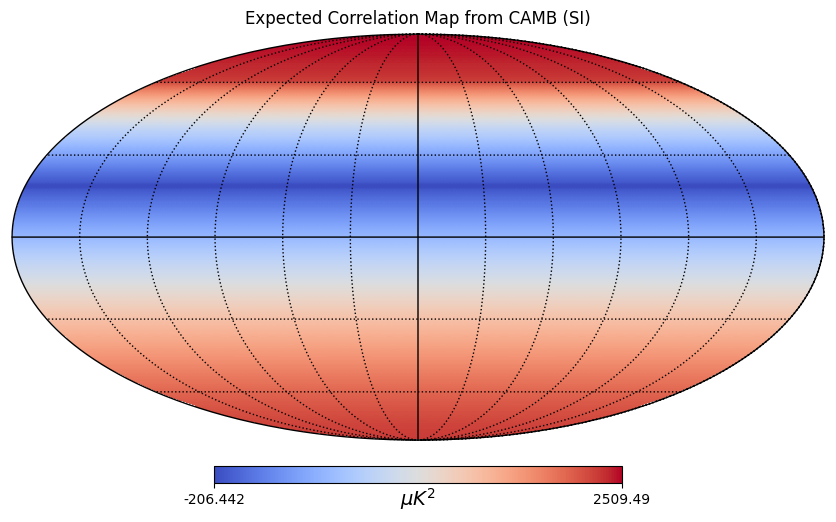

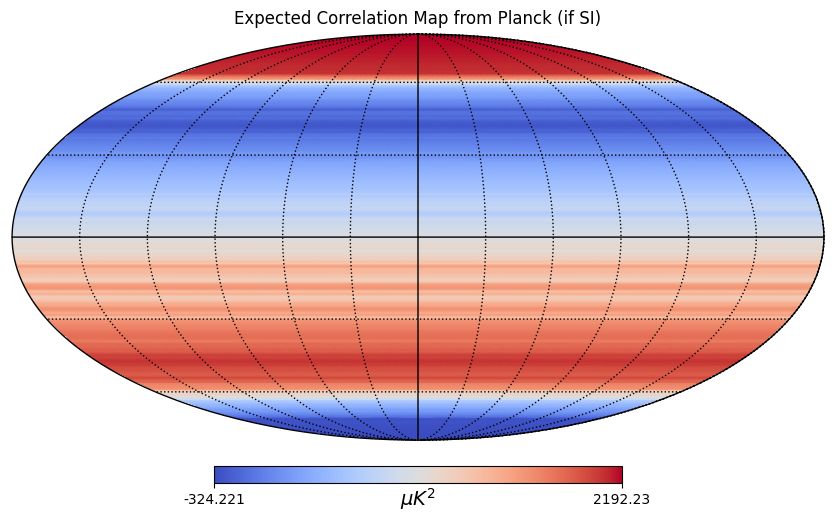

In [28]:
##  for the C_psi and C_psi_planck obtain correlation map.mro
nside = 512
npix = hp.nside2npix(nside)
c_psi_map_CAMB = np.zeros(npix)
c_psi_map_planck = np.zeros(npix)

theta_all, phi_all = hp.pix2ang(nside, np.arange(npix))  # Get pixel angles

# create a spline for C_psui and C_psi planck
from scipy.interpolate import interp1d
# c_psi_spline = interp1d(psi, c_psi, kind='cubic')
c_psi_spline = interp1d(psi, c_psi, kind='cubic', fill_value="extrapolate")

c_psi_planck_spline = interp1d(psi, c_psi_planck, kind='cubic', fill_value="extrapolate")

# for i in range(npix):
c_psi_map_CAMB = c_psi_spline(theta_all)
c_psi_map_planck = c_psi_planck_spline(theta_all)


# Plot the correlation map
# plt.figure(figsize=(7,4))
hp.mollview(c_psi_map_CAMB, title="Expected Correlation Map from CAMB (SI)", cmap="coolwarm", unit=r"$\mu K^2$", norm="hist")
hp.graticule()
plt.show()

# plt.figure(figsize=(7,4))
hp.mollview(c_psi_map_planck, title="Expected Correlation Map from Planck (if SI)", cmap="coolwarm", unit=r"$\mu K^2$", norm="hist")
hp.graticule()
plt.show()

## $C_{001}$ Analysis on the SI and nSI maps:

In [61]:
def get_C001(rmap, psi_values, Delta_psi):
    nside = hp.get_nside(rmap)
    C_001 = np.zeros_like(psi_values)
    theta_all, phi_all = hp.pix2ang(nside, np.arange(hp.nside2npix(nside)))

    # Calculate C_001(psi) = Integral dvarphi DeltaT(0,0) * DeltaT(psi, varphi)
    for i, psi in enumerate(psi_values):
        # Create an array to store the temperature differences
        temp_prod = []

        # Get the pixel angles
        same_theta_pixels = np.where((theta_all >= (psi - Delta_psi/2)) & (theta_all <= (psi + Delta_psi/2)))[0]
        temp_prod.append(rmap[hp.ang2pix(nside, theta_all[same_theta_pixels], phi_all[same_theta_pixels])]*rmap[hp.ang2pix(nside, 0, 0)])


        if len(temp_prod) > 0:
            # print(same_theta_pixels, theta_all[same_theta_pixels], phi_all[same_theta_pixels], np.mean(temp_prod))
            C_001[i] = np.mean(temp_prod)
        # if i % 200 == 0:
        #     print(f"{i}, psi: {psi}, C_001(psi):{C_001[i]}")

    return C_001

In [62]:
n_psi = 100
psi_values2 = np.linspace(0.004, np.pi-0.004, n_psi)
Delta_psi = 0.01

n_anchors = int(1000)

alpha = np.random.uniform(0, 2*np.pi, n_anchors)
beta = np.random.uniform(0, 2*np.pi, n_anchors)
gamma = np.random.uniform(0, 2*np.pi, n_anchors)
C_SI = np.zeros_like(psi_values2)
C_nSI = np.zeros_like(psi_values2)
C_nSI3 = np.zeros_like(psi_values2)

# Rotate the sky map using Healpy's rotator
for i, gam in enumerate(gamma):
    if i%100 ==0:
        print(f"Rotated Sky Map {i}: alpha={alpha[i]}, beta={beta[i]}, gamma={gam}")
    rotation= hp.rotator.Rotator( rot = [alpha[i], beta[i], gam], deg =False)

    rotated_SI_map = rotation.rotate_map_pixel(cmb_map)
    rotated_nSI_map = rotation.rotate_map_pixel(nSI_CMB_map)
    rotated_nSI_map2 = rotation.rotate_map_pixel(nSI_CMB_map3)
    # if abs(gam - np.pi/2) < 0.03:
    #     hp.mollview(

    C_SI += get_C001(rotated_SI_map, psi_values2, Delta_psi) 
    C_nSI += get_C001(rotated_nSI_map, psi_values2, Delta_psi) 
    C_nSI3 += get_C001(rotated_nSI_map2, psi_values2, Delta_psi)

C_SI /= n_anchors
C_nSI /= n_anchors
C_nSI3 /= n_anchors

Rotated Sky Map 0: alpha=3.3294992936817622, beta=5.699800064913496, gamma=2.116626912275213
Rotated Sky Map 100: alpha=2.985733294882284, beta=0.6921010627660782, gamma=2.864304884514512
Rotated Sky Map 200: alpha=5.695963483495876, beta=4.691506421828383, gamma=2.5787697435217503
Rotated Sky Map 300: alpha=3.040965165020604, beta=4.3016925231246805, gamma=0.9314457603955223
Rotated Sky Map 400: alpha=3.237861721790305, beta=2.7534925216040977, gamma=0.3622787990943907
Rotated Sky Map 500: alpha=2.9755055393648724, beta=2.4450666829104177, gamma=3.3522229823192364
Rotated Sky Map 600: alpha=5.522981530854471, beta=3.428487959365135, gamma=5.385123714514996
Rotated Sky Map 700: alpha=3.3922118230657987, beta=3.68655537703316, gamma=4.55127630949465
Rotated Sky Map 800: alpha=0.8947912059576313, beta=5.923371565690983, gamma=2.3915220975713187
Rotated Sky Map 900: alpha=3.663370140290465, beta=6.126441969809924, gamma=4.527074371326369


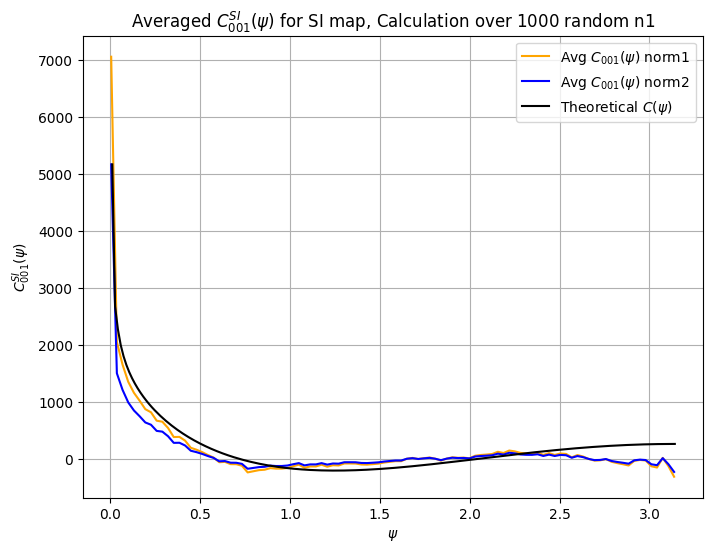

In [63]:
norm = np.sum(np.abs(c_psi))/np.sum(np.abs(C_SI))
norm2 = C_SI[0]/c_psi[0]

# ---- Plot the averaged C(psi) ----
plt.figure(figsize=(8, 6))

plt.plot(psi_values2, C_SI, color="orange", label=r"Avg $C_{001}(\psi)$ norm1")
plt.plot(psi_values2, C_SI/norm2, color="blue", label=r"Avg $C_{001}(\psi)$ norm2")

# plt.plot(psi_values2, c_planck_avg, color="blue", label=r"Avg $C_{001}(\psi)$ over 100 n1")

plt.plot(psi, c_psi, color='black', label=r'Theoretical $C(\psi)$')

plt.xlabel(r"$\psi$")
plt.ylabel(r"$C^{SI}_{001}(\psi)$")
plt.title(r"Averaged $C_{001}^{SI}(\psi)$ for SI map, Calculation over "+f"{n_anchors} random n1")
plt.legend()
plt.grid(True)
plt.show()

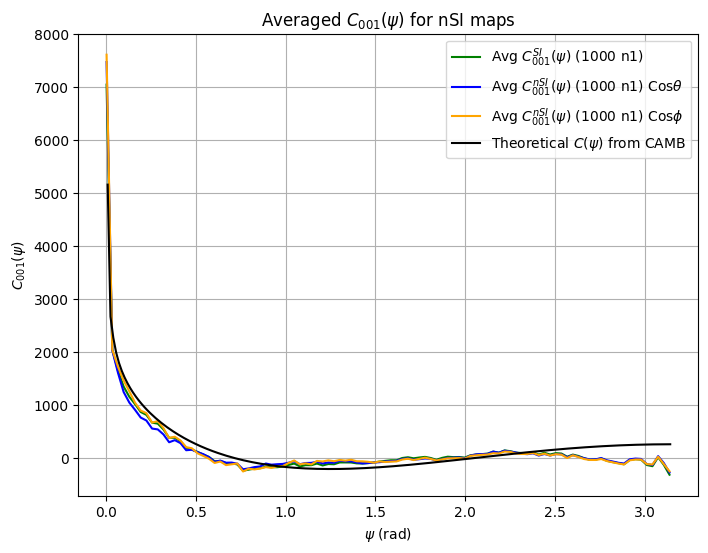

In [64]:
norm = C_nSI[0]/c_psi[0]
norm2 = C_nSI3[0]/c_psi[0]

# ---- Plot the averaged C(psi) ----
plt.figure(figsize=(8, 6))

# plt.plot(psi_values2, c_planck_avg1, color="orange", label=r"Avg $C_{001}(\psi)$ over 10 runs")
plt.plot(psi_values2, C_SI, color="green", label=r"Avg $C^{SI}_{001}(\psi)$ (1000 n1) ")
plt.plot(psi_values2, C_nSI, color="blue", label=r"Avg $C^{nSI}_{001}(\psi)$ (1000 n1) Cos$\theta$")
plt.plot(psi_values2, C_nSI3, color="orange", label=r"Avg $C^{nSI}_{001}(\psi)$ (1000 n1) Cos$\phi$")

plt.plot(psi, c_psi, color='black', label=r'Theoretical $C(\psi)$ from CAMB')

plt.xlabel(r"$\psi$ (rad)")
plt.ylabel(r"$C_{001}(\psi)$")
plt.title(r"Averaged $C_{001}(\psi)$ for nSI maps")
plt.legend()
plt.grid(True)
plt.show()

## Generate Additive non-Statistical Isotropic character (Lorentz boost)

In [9]:
def get_AnSI_Map(o_map, A,p, nside, f= "cos"):
    """
    Function to generate a non-Gaussian CMB map with nSI signal
    Parameters:
    o_map: Original CMB map
    A: Lorentz boost amplitude
    p: movement Direction
    nside: HEALPix resolution parameter (default=512)
    f: Function to generate anisotropy
    Returns:
    nSI_map: CMB map with nSI signal
    """
    npix = hp.nside2npix(nside)
    vecs = np.array(hp.pix2vec(nside, np.arange(npix))) # Get pixel coordinates
    dot_prod = np.einsum('i,ij->j', p, vecs)
    if f == "cos":
        F = dot_prod
    elif f == "sin":
        F = np.sqrt(1 - dot_prod**2)
    AnSI_map = o_map + A*F  
    return AnSI_map

theta_hotspot: 41.747, phi_hotspot: 264.021
X: -0.06935679209477572, Y: -0.6622205112469008, Z: 0.7460922395215054


<Figure size 700x400 with 0 Axes>

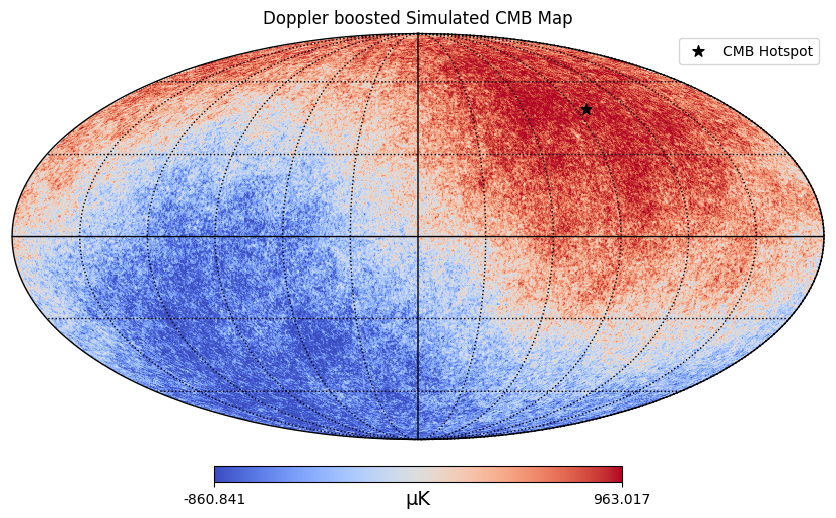

<Figure size 700x400 with 0 Axes>

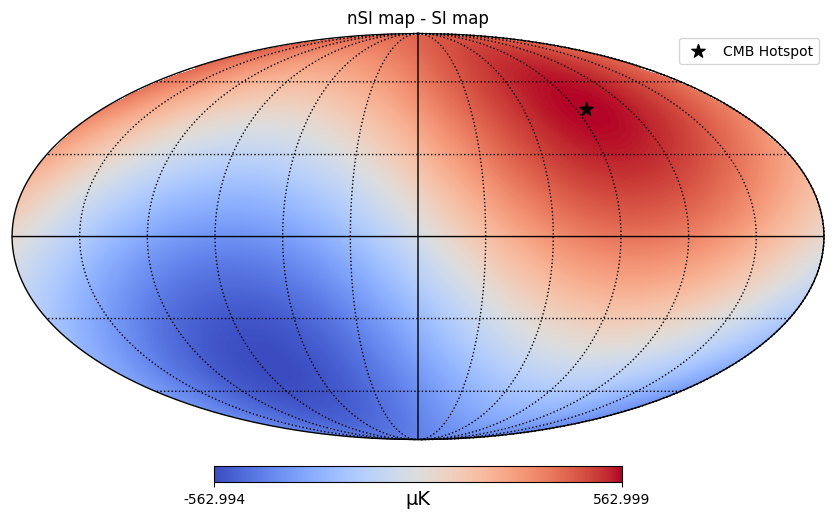

In [ ]:
# Mark the hotspot location
l, b = 264.021, 48.253  # Galactic coordinates
theta = np.radians(90 - b)
phi = np.radians(l)
print(f"theta_hotspot: {90-b}, phi_hotspot: {l}")
X = np.sin(theta)*np.cos(phi)
Y = np.sin(theta)*np.sin(phi)
Z = np.cos(theta)
print(f"X: {X}, Y: {Y}, Z: {Z}")

AnSI_CMB_map = get_AnSI_Map(cmb_map, 1*cmb_map.max(), [X, Y, Z], nside)

# output_filename = "/output/nSI_CMB_map_doppler_boost.fits"
# hp.write_map(output_filename, AnSI_CMB_map, overwrite=True)
# print(f"Map saved successfully as {output_filename}")

plt.figure(figsize=(7,4))
hp.mollview(AnSI_CMB_map, title="Doppler boosted Simulated CMB Map", cmap="coolwarm", unit="μK", norm="hist")
hp.projscatter(theta, phi, marker='*', color='black', s=70, label="CMB Hotspot")
plt.legend()
hp.graticule()
# plt.savefig("output/CMB_Doppler_boost.png", dpi = 600)
plt.show()

plt.figure(figsize=(7,4))
hp.mollview(AnSI_CMB_map-cmb_map, title="nSI map - SI map", cmap="coolwarm", unit="μK", norm="hist")
hp.graticule()
hp.projscatter(theta, phi, marker='*', color='black', s=70, label="CMB Hotspot")
plt.legend()
plt.show()

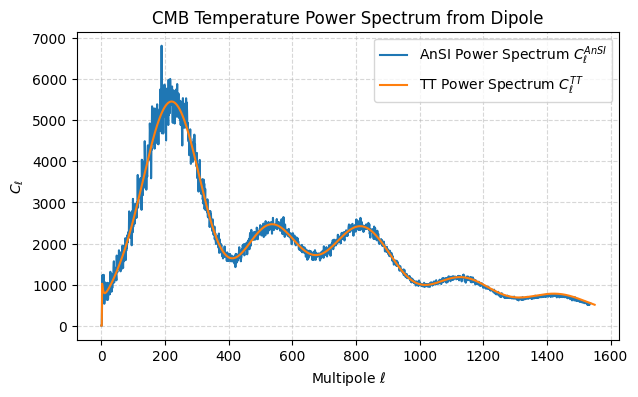

In [67]:
cl_lorentz = hp.anafast(AnSI_CMB_map, lmax=lmax)
cl_lorentz[1] = 0
ell3= np.arange(cl_lorentz.shape[0])

plt.figure(figsize=(7,4))
plt.plot(ell3,1 / (2 * np.pi) * cl_lorentz* (ell3* (ell3+ 1)), label=r'AnSI Power Spectrum $C_\ell^{AnSI}$')
plt.plot(ell, 1 / (2 * np.pi) * cl_tt * (ell * (ell + 1)), label=r'TT Power Spectrum $C_\ell^{TT}$')
plt.xlabel(r'Multipole $\ell$')
plt.ylabel(r'$C_\ell$')
plt.title('CMB Temperature Power Spectrum from Dipole')
# plt.xlim(2, lmax)
plt.grid(True, which='both', ls='--', alpha=0.5)
plt.legend()
plt.show()

## Calculate Anchored Correlation by Ensemble Averages:

### (1) for the SI map  + (2) for the nSI maps

In [68]:
def get_C001_psi(map):

    "Here the given map is the Ensemble Averaged correlation map produced earlier"
    nside = hp.get_nside(map)
    theta_all, phi_all = hp.pix2ang(nside, np.arange(hp.nside2npix(nside))) # Get pixel angles

    unique_theta = np.unique(theta_all)  # Get unique theta values
    num_unique_theta = len(unique_theta)  # Count unique values

    print(f"Number of distinct theta values: {num_unique_theta}")
    print(f"Unique theta values: {unique_theta}")


    C_0001_EA = np.zeros_like(unique_theta) # Array to store the C_001 values

    for i, theta in enumerate(unique_theta):
        same_theta_pixels = np.where(theta_all == theta)[0]
        C_0001_EA[i] = np.mean(map[same_theta_pixels])  

    return unique_theta, C_0001_EA

In [69]:
# ---- Compute C_001(psi) for nSI map----
n_realizations = 1000

A = 0.5
p = [0,0,1]

count  = 0
Anchored_correlation = np.zeros_like(cmb_map)
Anchored_correlation_nSI = np.zeros_like(cmb_map)
Anchored_correlation_nSI2 = np.zeros_like(cmb_map)

for i in range(n_realizations):
    if i%100 == 0:
        print(f"Realization {i}")
    cmb_map = hp.synfast(cl_tt, nside=nside, lmax=lmax, new=True)
    nSI_map = get_nSI_Map(cmb_map, A, p, nside, f='cos')
    nSI_map2 = get_nSI_Map(cmb_map, A, p, nside, f=phi_function)

    T_001 = cmb_map[hp.ang2pix(nside, 0, 0)]
    T1_001 = nSI_map[hp.ang2pix(nside, 0, 0)]
    T2_001 = nSI_map2[hp.ang2pix(nside, 0, 0)]

    Anchored_correlation += cmb_map * T_001
    Anchored_correlation_nSI += nSI_map * T1_001
    Anchored_correlation_nSI2 += nSI_map2 * T2_001


Anchored_correlation /= n_realizations
Anchored_correlation_nSI /= n_realizations
Anchored_correlation_nSI2 /= n_realizations

Realization 0
Realization 100
Realization 200
Realization 300
Realization 400
Realization 500
Realization 600
Realization 700
Realization 800
Realization 900


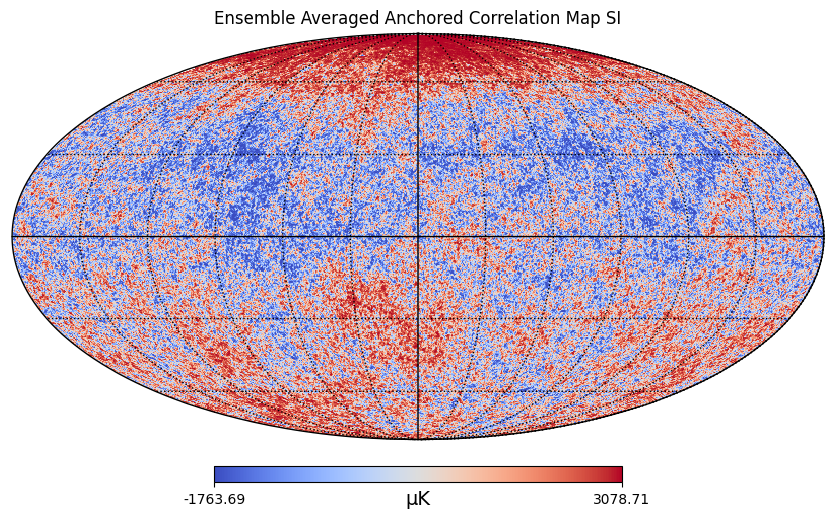

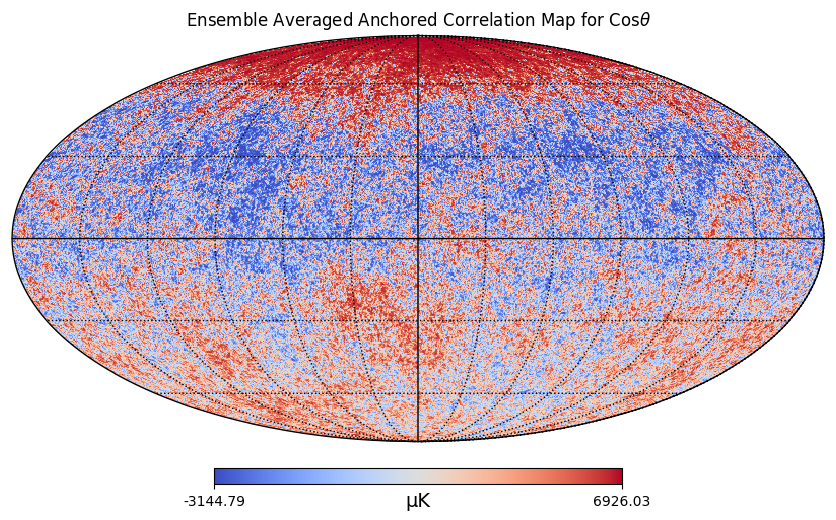

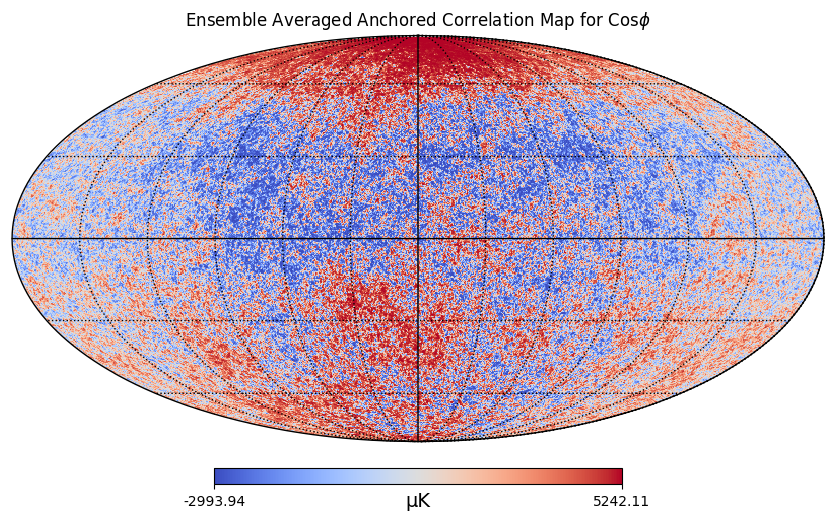

In [70]:
# plot the Correlation as Healpix map
hp.mollview(Anchored_correlation, title="Ensemble Averaged Anchored Correlation Map SI", norm ="hist", cmap="coolwarm", unit="μK")
hp.graticule()
plt.show()

# plot the Correlation(psi, varphi) as Healpix map with theta nSI
hp.mollview(Anchored_correlation_nSI, title=r"Ensemble Averaged Anchored Correlation Map for Cos$\theta$", norm ="hist", cmap="coolwarm", unit="μK")
hp.graticule()
plt.show()

# plot the Correlation(psi, varphi) as Healpix map with phi nSI
hp.mollview(Anchored_correlation_nSI2, title=r"Ensemble Averaged Anchored Correlation Map for Cos$\phi$", norm ="hist", cmap="coolwarm", unit="μK")
hp.graticule()
plt.show()

In [71]:
psi_values, C_001_EA = get_C001_psi(Anchored_correlation)
psi_values_nSI, C_001_EA_nSI1 = get_C001_psi(Anchored_correlation_nSI)
psi_values_nSI2, C_001_EA_nSI2 = get_C001_psi(Anchored_correlation_nSI2)

Number of distinct theta values: 2047
Unique theta values: [1.59472005e-03 3.18944112e-03 4.78416422e-03 ... 3.13680849e+00
 3.13840321e+00 3.13999793e+00]
Number of distinct theta values: 2047
Unique theta values: [1.59472005e-03 3.18944112e-03 4.78416422e-03 ... 3.13680849e+00
 3.13840321e+00 3.13999793e+00]
Number of distinct theta values: 2047
Unique theta values: [1.59472005e-03 3.18944112e-03 4.78416422e-03 ... 3.13680849e+00
 3.13840321e+00 3.13999793e+00]


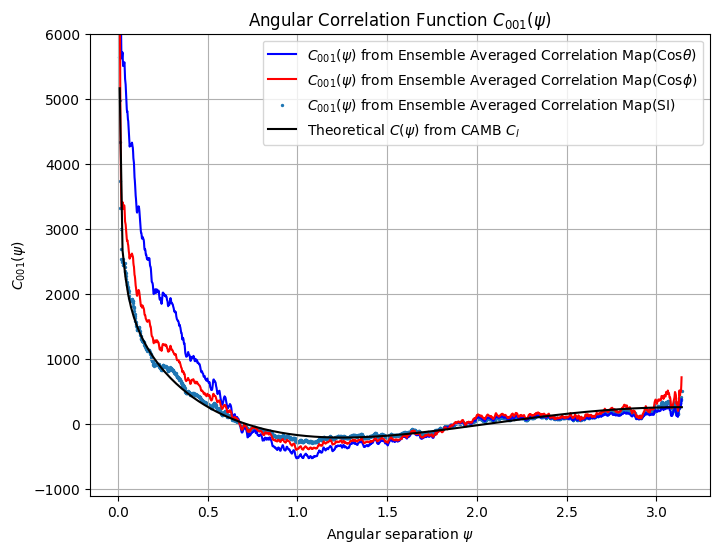

In [72]:
# plot the Correlation as C_001(psi) plot using the Ensemble Averaged correlation map

plt.figure(figsize=(8, 6))
plt.plot(psi_values_nSI, C_001_EA_nSI1, color='b', label=r'$C_{001}(\psi)$ from Ensemble Averaged Correlation Map(Cos$\theta$)')
plt.plot(psi_values_nSI2, C_001_EA_nSI2, color='r', label=r'$C_{001}(\psi)$ from Ensemble Averaged Correlation Map(Cos$\phi$)')
plt.scatter(psi_values, C_001_EA, label=r'$C_{001}(\psi)$ from Ensemble Averaged Correlation Map(SI)', s =2)
plt.plot(psi, c_psi, color='black', label=r'Theoretical $C(\psi)$ from CAMB $C_l$')
plt.xlabel(r'Angular separation $\psi$')
plt.ylabel(r'$C_{001}(\psi)$')
plt.ylim(-1100, 6000)
plt.title('Angular Correlation Function $C_{001}(\psi)$')
plt.legend()
plt.grid()
plt.show()

Number of distinct theta values: 2047
Unique theta values: [1.59472005e-03 3.18944112e-03 4.78416422e-03 ... 3.13680849e+00
 3.13840321e+00 3.13999793e+00]
Number of distinct theta values: 2047
Unique theta values: [1.59472005e-03 3.18944112e-03 4.78416422e-03 ... 3.13680849e+00
 3.13840321e+00 3.13999793e+00]


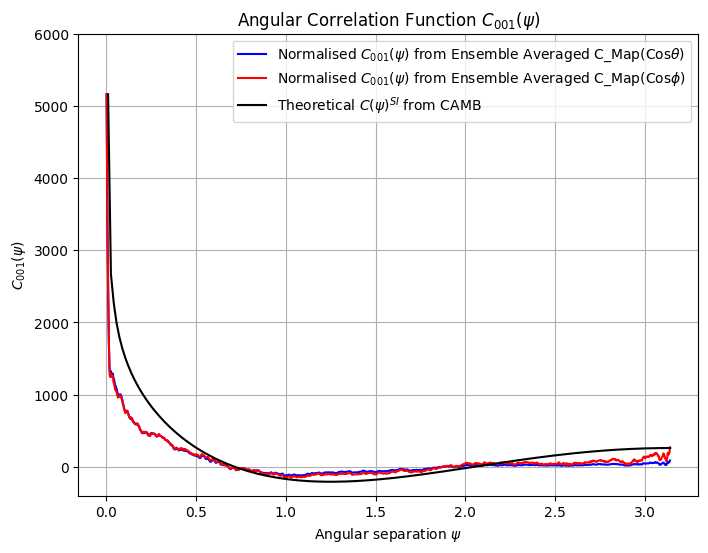

In [73]:
norm1 = C_001_EA_nSI1[0]/c_psi[0]
norm2 = C_001_EA_nSI2[0]/c_psi[0]

# plot the Correlation as C_001(psi) plot using the Ensemble Averaged correlation map

psi_values_nSI, C_001_EA_nSI1 = get_C001_psi(Anchored_correlation_nSI)
psi_values_nSI2, C_001_EA_nSI2 = get_C001_psi(Anchored_correlation_nSI2)

plt.figure(figsize=(8, 6))
plt.plot(psi_values_nSI, C_001_EA_nSI1/norm1, color='b', label=r'Normalised $C_{001}(\psi)$ from Ensemble Averaged C_Map(Cos$\theta$)')
plt.plot(psi_values_nSI2, C_001_EA_nSI2/norm2, color='r', label=r'Normalised $C_{001}(\psi)$ from Ensemble Averaged C_Map(Cos$\phi$)')
plt.plot(psi, c_psi, color='black', label=r'Theoretical $C(\psi)^{SI}$ from CAMB')
plt.xlabel(r'Angular separation $\psi$')
plt.ylabel(r'$C_{001}(\psi)$')
plt.ylim(-400, 6000)
plt.title('Angular Correlation Function $C_{001}(\psi)$')
plt.legend()
plt.grid()
plt.show()

In [74]:
# hp.write_map("correlation_maps.fits", [Anchored_correlation2, Anchored_correlation_nSI, Anchored_correlation_nSI2, Anchored_correlation_nSI3, Anchored_correlation_nSI4])#, overwrite=True)

C($\varphi$)

In [84]:
def get_C001_phi(map, n_phi = 1000):

    "Here the given map is the Ensemble Averaged correlation map produced earlier"
    
    nside = hp.get_nside(map)
    theta_all, phi_all = hp.pix2ang(nside, np.arange(hp.nside2npix(nside))) # Get pixel angles

    if n_phi == False:
        unique_phi = np.unique(phi_all)  # Get unique theta values
        unique_phi = unique_phi[::5]
        num_unique_phi = len(unique_phi)  # Count unique values
    else:
        Delta_phi = 2*np.pi / n_phi
        unique_phi = np.linspace(0, 2*np.pi, n_phi)  # Get unique theta values

    print(f"Number of distinct phi values: { len(unique_phi) }")
    # print(f"Unique phi values: {unique_phi}")


    C_0001_EA = np.zeros_like(unique_phi) # Array to store the C_001 values

    for i, phi in enumerate(unique_phi):
        if n_phi == False:
            same_phi_pixels = np.where(phi_all == phi)[0]
        else:
            same_phi_pixels = np.where((phi_all >= (phi - Delta_phi/2)) & (phi_all <= (phi + Delta_phi/2)))[0]
        C_0001_EA[i] = np.mean(map[same_phi_pixels])  

    return unique_phi, C_0001_EA

In [85]:
phi_values_SI, C_001_EA_phi_SI = get_C001_phi(Anchored_correlation, n_phi = False)
phi_values_nSI, C_001_EA_phi_nSI1 = get_C001_phi(Anchored_correlation_nSI, n_phi = False)
phi_values_nSI2, C_001_EA_phi_nSI2 = get_C001_phi(Anchored_correlation_nSI2, n_phi = False)

Number of distinct phi values: 89474
Number of distinct phi values: 89474
Number of distinct phi values: 89474


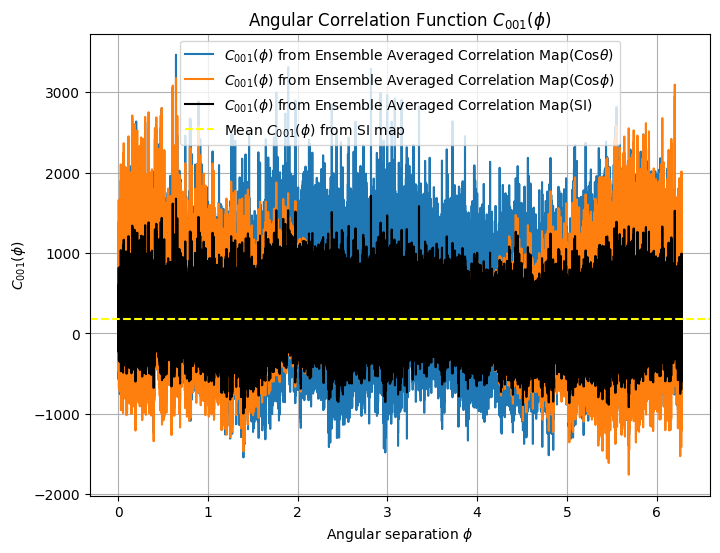

In [86]:

# plot Each of these C_001(phi) for SI and nSI maps
plt.figure(figsize=(8, 6))
plt.plot(phi_values_nSI, C_001_EA_phi_nSI1, label=r'$C_{001}(\phi)$ from Ensemble Averaged Correlation Map(Cos$\theta$)')
plt.plot(phi_values_nSI2, C_001_EA_phi_nSI2, label=r'$C_{001}(\phi)$ from Ensemble Averaged Correlation Map(Cos$\phi$)')
plt.plot(phi_values_SI, C_001_EA_phi_SI, color='black', label=r'$C_{001}(\phi)$ from Ensemble Averaged Correlation Map(SI)')
plt.axhline(np.mean(C_001_EA_phi_SI), color='Yellow', linestyle='--', label=r'Mean $C_{001}(\phi)$ from SI map')
plt.xlabel(r'Angular separation $\phi$')
plt.ylabel(r'$C_{001}(\phi)$')
plt.title('Angular Correlation Function $C_{001}(\phi)$')  
plt.legend()
plt.grid()
plt.show()

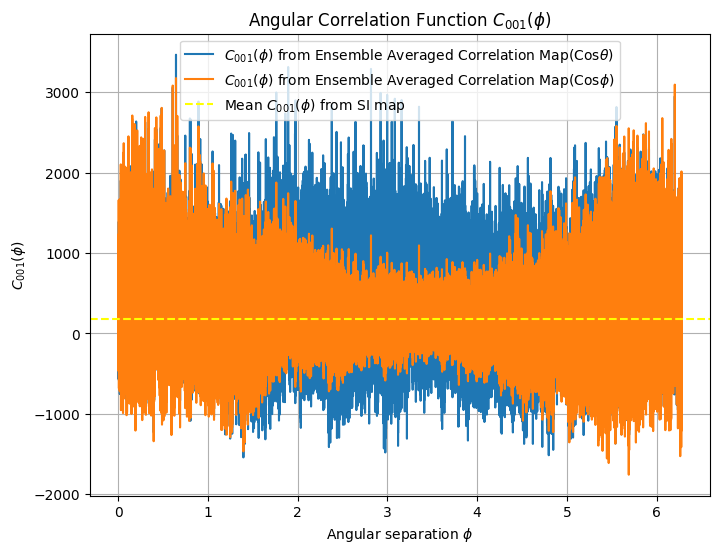

In [87]:
# plot Each of these C_001(phi) for SI and nSI maps
plt.figure(figsize=(8, 6))
plt.plot(phi_values_nSI, C_001_EA_phi_nSI1, label=r'$C_{001}(\phi)$ from Ensemble Averaged Correlation Map(Cos$\theta$)')
plt.plot(phi_values_nSI2, C_001_EA_phi_nSI2, label=r'$C_{001}(\phi)$ from Ensemble Averaged Correlation Map(Cos$\phi$)')
# plt.plot(phi_values_nSI3, C_001_EA_phi_nSI3, color='g', label=r'$C_{001}(\phi)$ from Ensemble Averaged Correlation Map(nSI3)')
# plt.plot(phi_values_nSI4, C_001_EA_phi_nSI4, color='y', label=r'$C_{001}(\phi)$ from Ensemble Averaged Correlation Map(nSI4)')
# plt.plot(phi_values_SI, C_001_EA_phi_SI, color='black', label=r'$C_{001}(\phi)$ from Ensemble Averaged Correlation Map(SI)')
plt.axhline(np.mean(C_001_EA_phi_SI), color='Yellow', linestyle='--', label=r'Mean $C_{001}(\phi)$ from SI map')
plt.xlabel(r'Angular separation $\phi$')
plt.ylabel(r'$C_{001}(\phi)$')
plt.title('Angular Correlation Function $C_{001}(\phi)$')  
plt.legend()
plt.grid()
plt.show()

# Spatial Averaging of Anchored Correlation Function

In [88]:
def get_anchored_correlation(map, alpha, beta, gamma):

    """Compute the C_001(psi, phi) correlation function for a map, by averaging over n anchor points."""
    Anchored_correlation = np.zeros_like(map)
    nside = hp.get_nside(map)
    
    for i in range(len(gamma)):
        if i % 50 == 0:
            print(f"Rotated Sky Map {i}: alpha={alpha[i]}, beta={beta[i]}, gamma={gamma[i]}")
        rotation= hp.rotator.Rotator( rot = [alpha[i], beta[i], gamma[i]], deg =False)
        rotated_map = rotation.rotate_map_pixel(map)
        T_001 = rotated_map[hp.ang2pix(nside, 0, 0)]
        Anchored_correlation += T_001 * rotated_map

    return Anchored_correlation / len(gamma)

## SI + nSI spatial Averaging


In [89]:
n_anchors = int(1000)

alpha = np.random.uniform(0, 2*np.pi, n_anchors)
beta = np.random.uniform(0, 2*np.pi, n_anchors)
gamma = np.random.uniform(0, 2*np.pi, n_anchors)

print(F"Calculating Anchored Correlation for SI map ({n_anchors})")
Anchored_correlation_SA_SI = get_anchored_correlation(cmb_map, alpha, beta, gamma)
print(F"Calculating Anchored Correlation for nSI map cos(theta) ({n_anchors})")
Anchored_correlation_SA_nSI = get_anchored_correlation(nSI_CMB_map, alpha, beta, gamma)
print(F"Calculating Anchored Correlation for nSI map cos(phi) ({n_anchors})")
Anchored_correlation_SA_nSI2 = get_anchored_correlation(nSI_CMB_map3, alpha, beta, gamma)

# plot the Correlation as C_001(psi) plot using the Spatially Averaged correlation map
psi_values, C_001_SA_SI = get_C001_psi(Anchored_correlation_SA_SI)
psi_values, C_001_SA1 = get_C001_psi(Anchored_correlation_SA_nSI)
psi_values, C_001_SA2 = get_C001_psi(Anchored_correlation_SA_nSI2)

Calculating Anchored Correlation for SI map (1000)
Rotated Sky Map 0: alpha=3.1701057462111883, beta=5.847748739232976, gamma=1.160692740433009
Rotated Sky Map 50: alpha=1.9350047728747892, beta=5.852115692426469, gamma=3.1025078507055626
Rotated Sky Map 100: alpha=1.5448852990856212, beta=2.980277724727237, gamma=0.008544326223725526
Rotated Sky Map 150: alpha=1.5150363588580429, beta=4.062416560908708, gamma=3.9945287639062097
Rotated Sky Map 200: alpha=1.2351177869115069, beta=2.7337522735052504, gamma=4.524673936597685
Rotated Sky Map 250: alpha=0.46987599217922116, beta=4.1415215672681605, gamma=1.60501725893792
Rotated Sky Map 300: alpha=1.458576376560741, beta=5.595255905265814, gamma=4.8244153981552556
Rotated Sky Map 350: alpha=5.408854995197881, beta=1.2282052940505908, gamma=5.95757643385721
Rotated Sky Map 400: alpha=4.308747301091115, beta=3.053786504026738, gamma=4.468247376770627
Rotated Sky Map 450: alpha=2.5305279681696944, beta=3.3752256578422557, gamma=1.651264135107

In [90]:
# save the Anchored correlation maps
hp.write_map("SA_Anchored_correlation_map_SI_512.fits", Anchored_correlation_SA_SI, overwrite=True)
hp.write_map("SA_Anchored_correlation_map_nSI_512.fits", Anchored_correlation_SA_nSI, overwrite=True)
hp.write_map("SA_Anchored_correlation_map_nSI2_512.fits", Anchored_correlation_SA_nSI2, overwrite=True)

setting the output map dtype to [dtype('float64')]
setting the output map dtype to [dtype('float64')]
setting the output map dtype to [dtype('float64')]


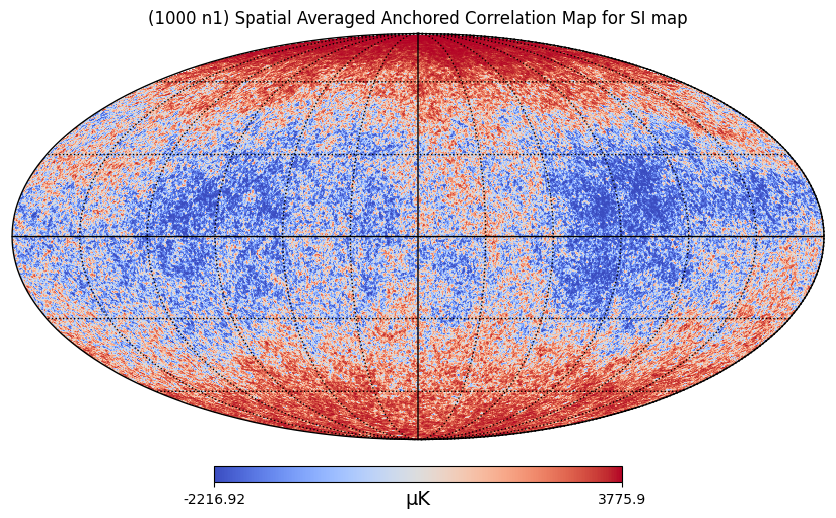

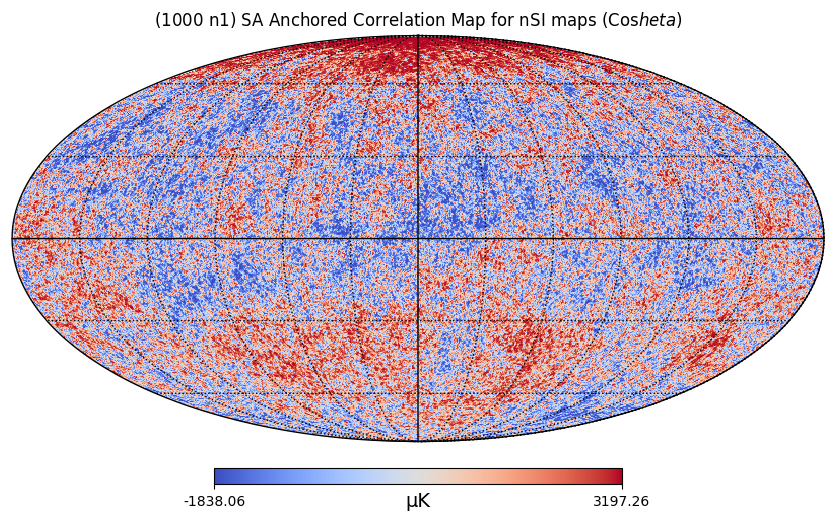

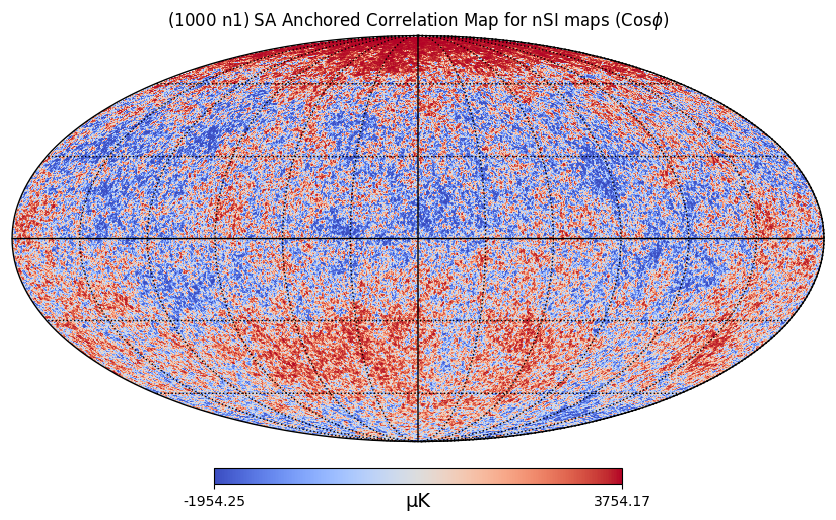

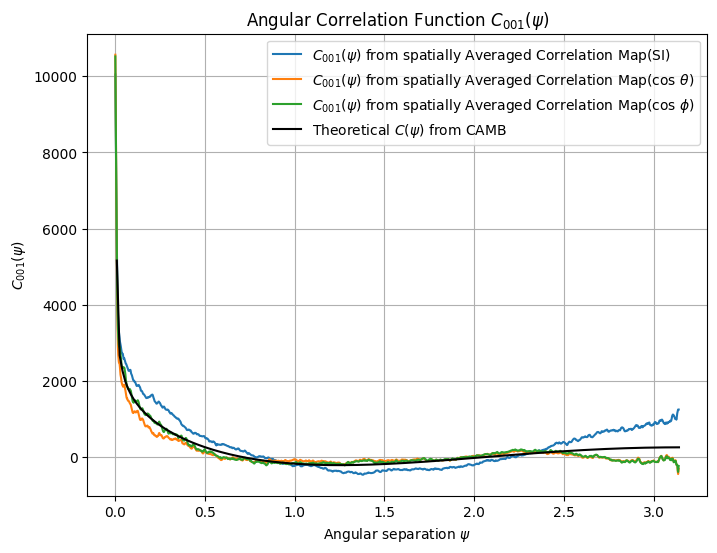

In [ ]:
hp.mollview(Anchored_correlation_SA_SI, title=f"({n_anchors} n1) Spatial Averaged Anchored Correlation Map for SI map", norm = "hist", cmap="coolwarm", unit="μK")
hp.graticule()
plt.show()

hp.mollview(Anchored_correlation_SA_nSI, title=rf"({n_anchors} n1) SA Anchored Correlation Map for nSI maps (Cos$\theta$)", norm = "hist", cmap="coolwarm", unit="μK")
hp.graticule()
plt.show()

hp.mollview(Anchored_correlation_SA_nSI2, title=rf"({n_anchors} n1) SA Anchored Correlation Map for nSI maps (Cos$\phi$)", norm = "hist", cmap="coolwarm", unit="μK")
hp.graticule()
plt.show()

plt.figure(figsize=(8, 6))
plt.plot(psi_values, C_001_SA_SI, label=r'$C_{001}(\psi)$ from spatially Averaged Correlation Map(SI)')
plt.plot(psi_values, C_001_SA1, label=r'$C_{001}(\psi)$ from spatially Averaged Correlation Map(cos $\theta$)')
plt.plot(psi_values, C_001_SA2, label=r'$C_{001}(\psi)$ from spatially Averaged Correlation Map(cos $\phi$)')
plt.plot(psi, c_psi, color='black', label=r'Theoretical $C(\psi)$ from CAMB')
plt.xlabel(r'Angular separation $\psi$')
plt.ylabel(r'$C_{001}(\psi)$')
plt.title('Angular Correlation Function $C_{001}(\psi)$')
plt.legend()
plt.grid()
plt.show()

In [92]:
phi_values_SI, C_001_SA_phi_SI = get_C001_phi(Anchored_correlation_SA_SI, n_phi = False)
phi_values_nSI, C_001_SA_phi_nSI = get_C001_phi(Anchored_correlation_SA_nSI, n_phi = False)
phi_values_nSI2, C_001_SA_phi_nSI2 = get_C001_phi(Anchored_correlation_SA_nSI2, n_phi = False)

Number of distinct phi values: 89474
Number of distinct phi values: 89474
Number of distinct phi values: 89474


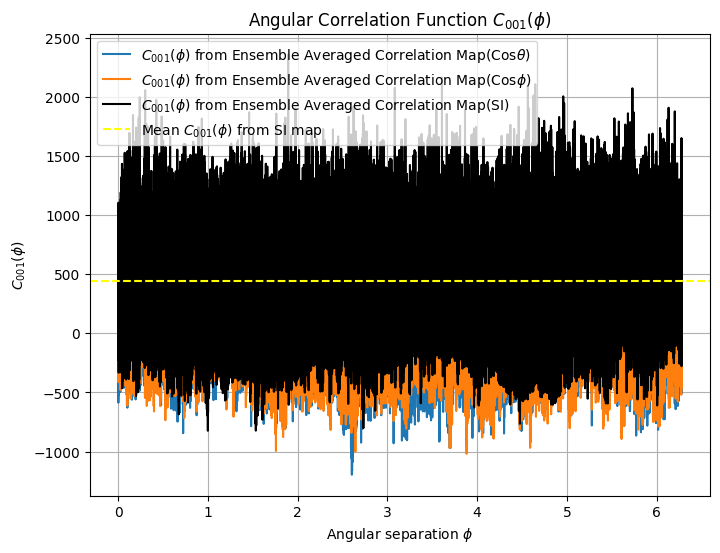

In [93]:
# plot Each of these C_001(phi) for SI and nSI maps
plt.figure(figsize=(8, 6))
plt.plot(phi_values_nSI, C_001_SA_phi_nSI, label=r'$C_{001}(\phi)$ from Ensemble Averaged Correlation Map(Cos$\theta$)')
plt.plot(phi_values_nSI2, C_001_SA_phi_nSI2, label=r'$C_{001}(\phi)$ from Ensemble Averaged Correlation Map(Cos$\phi$)')
plt.plot(phi_values_SI, C_001_SA_phi_SI, color='black', label=r'$C_{001}(\phi)$ from Ensemble Averaged Correlation Map(SI)')
plt.axhline(np.mean(C_001_SA_phi_SI), color='Yellow', linestyle='--', label=r'Mean $C_{001}(\phi)$ from SI map')
plt.xlabel(r'Angular separation $\phi$')
plt.ylabel(r'$C_{001}(\phi)$')
plt.title('Angular Correlation Function $C_{001}(\phi)$')  
plt.legend()
plt.grid()
plt.show()

## Ensemble Averaging + $n_1$ averaging (100 n1 constant across each realization)

In [94]:
# ---- Compute C_001(psi) for nSI map----
n_psi = 100
psi_values2 = np.linspace(0.004, np.pi-0.004, n_psi)
Delta_psi = 0.01

n_anchors = int(100)

alpha = np.random.uniform(0, 2*np.pi, n_anchors)
beta = np.random.uniform(0, 2*np.pi, n_anchors)
gamma = np.random.uniform(0, 2*np.pi, n_anchors)
C_nSI = np.zeros_like(psi_values2)
C_nSI3 = np.zeros_like(psi_values2)

n_realizations = 100

A = 1
p = [0,0,1]

count  = 0
Anchored_correlation_nSI3 = np.zeros_like(cmb_map)
Anchored_correlation_nSI4 = np.zeros_like(cmb_map)

for i in range(n_realizations):
    # if i == 0:
    print(f"Realization {i}")
    cmb_map = hp.synfast(cl_tt, nside=nside, lmax=lmax, new=True)
    nSI_map = get_nSI_Map(cmb_map, A, p, nside, f='cos')
    nSI_map2 = get_nSI_Map(cmb_map, A, p, nside, f=phi_function)

    # Rotate the sky map using Healpy's rotator
    for j, gam in enumerate(gamma):
        A_corr = np.zeros_like(psi_values2)
        A_corr2 = np.zeros_like(psi_values2)
        # print(f"Rotated Sky Map {j}: alpha={alpha[j]}, beta={beta[j]}, gamma={gam}")
        rotation= hp.rotator.Rotator( rot = [alpha[j], beta[j], gam], deg =False)

        rotated_nSI_map = rotation.rotate_map_pixel(nSI_map)
        rotated_nSI_map2 = rotation.rotate_map_pixel(nSI_map2)

        T_001 = rotated_nSI_map[hp.ang2pix(nside, 0, 0)]
        T2_001 = rotated_nSI_map2[hp.ang2pix(nside, 0, 0)]

        Anchored_correlation_nSI3 += rotated_nSI_map * T_001
        Anchored_correlation_nSI4 += rotated_nSI_map2 * T2_001
        
Anchored_correlation_nSI3 /= (n_realizations*n_anchors)
Anchored_correlation_nSI4 /= (n_realizations*n_anchors)

Realization 0
Realization 1
Realization 2
Realization 3
Realization 4
Realization 5
Realization 6
Realization 7
Realization 8
Realization 9
Realization 10
Realization 11
Realization 12
Realization 13
Realization 14
Realization 15
Realization 16
Realization 17
Realization 18
Realization 19
Realization 20
Realization 21
Realization 22
Realization 23
Realization 24
Realization 25
Realization 26
Realization 27
Realization 28
Realization 29
Realization 30
Realization 31
Realization 32
Realization 33
Realization 34
Realization 35
Realization 36
Realization 37
Realization 38
Realization 39
Realization 40
Realization 41
Realization 42
Realization 43
Realization 44
Realization 45
Realization 46
Realization 47
Realization 48
Realization 49
Realization 50
Realization 51
Realization 52
Realization 53
Realization 54
Realization 55
Realization 56
Realization 57
Realization 58
Realization 59
Realization 60
Realization 61
Realization 62
Realization 63
Realization 64
Realization 65
Realization 66
Reali

In [95]:
psi_values_nSI, C_001_EA_nSI3 = get_C001_psi(Anchored_correlation_nSI3)
psi_values_nSI2, C_001_EA_nSI4 = get_C001_psi(Anchored_correlation_nSI4)

Number of distinct theta values: 2047
Unique theta values: [1.59472005e-03 3.18944112e-03 4.78416422e-03 ... 3.13680849e+00
 3.13840321e+00 3.13999793e+00]
Number of distinct theta values: 2047
Unique theta values: [1.59472005e-03 3.18944112e-03 4.78416422e-03 ... 3.13680849e+00
 3.13840321e+00 3.13999793e+00]


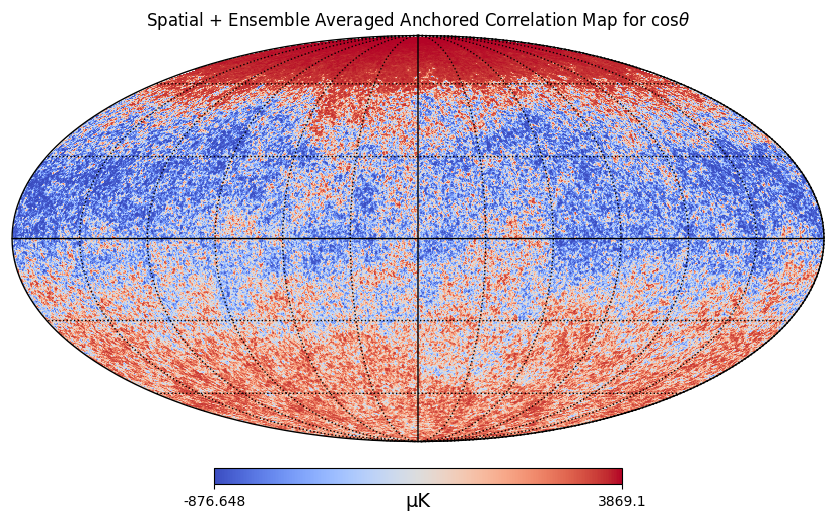

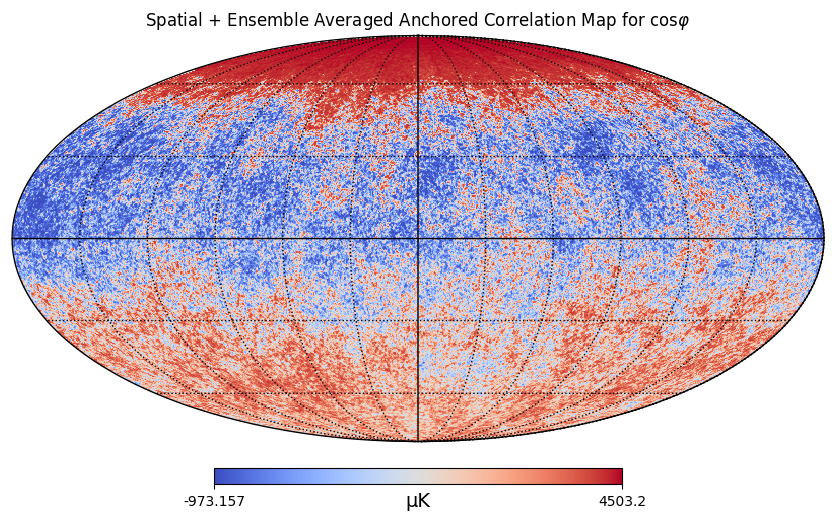

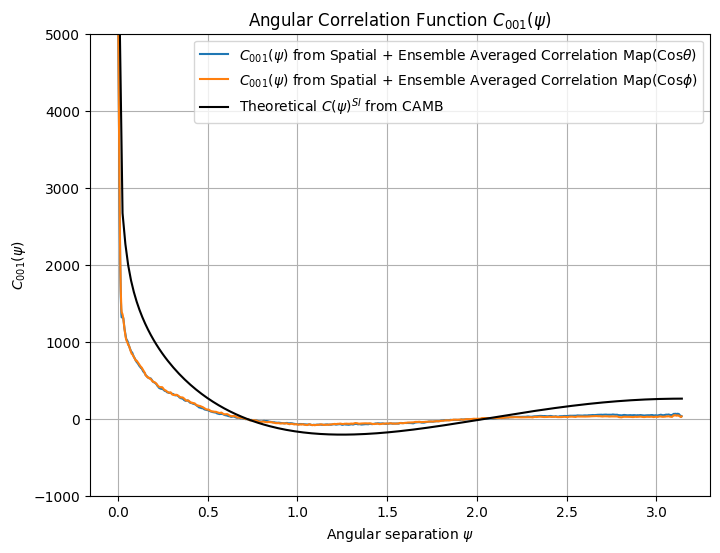

In [96]:
# plot the Correlation(psi, varphi) as Healpix map with theta nSI
hp.mollview(Anchored_correlation_nSI3, title=r"Spatial + Ensemble Averaged Anchored Correlation Map for cos$\theta$ ", norm="hist" , cmap="coolwarm" ,unit="μK")
hp.graticule()
plt.show()

# plot the Correlation(psi, varphi) as Healpix map with phi nSI
hp.mollview(Anchored_correlation_nSI4, title=r"Spatial + Ensemble Averaged Anchored Correlation Map for cos$\varphi$", norm="hist" , cmap="coolwarm", unit="μK")
hp.graticule()
plt.show()

norm3  = c_psi[0]/C_001_EA_nSI3[0]
norm4  = c_psi[0]/C_001_EA_nSI4[0]

# plot the Correlation as C_001(psi) plot using the Ensemble Averaged correlation map
plt.figure(figsize=(8, 6))
# plt.plot(psi_values_nSI, C_001_EA_nSI1,label=r'$C_{001}(\psi)$ from Ensemble Averaged Correlation Map(nSI1)')
# plt.plot(psi_values_nSI2, C_001_EA_nSI2, label=r'$C_{001}(\psi)$ from Ensemble Averaged Correlation Map(nSI2)')
plt.plot(psi_values_nSI, C_001_EA_nSI3*norm3, label=r'$C_{001}(\psi)$ from Spatial + Ensemble Averaged Correlation Map(Cos$\theta$)')
plt.plot(psi_values_nSI2, C_001_EA_nSI4*norm4, label=r'$C_{001}(\psi)$ from Spatial + Ensemble Averaged Correlation Map(Cos$\phi$)')

plt.plot(psi, c_psi, color='black', label=r'Theoretical $C(\psi)^{SI}$ from CAMB')
plt.xlabel(r'Angular separation $\psi$')
plt.ylabel(r'$C_{001}(\psi)$')
plt.title('Angular Correlation Function $C_{001}(\psi)$')
plt.legend()
plt.ylim(-1000, 5000)
plt.grid()
plt.show()


# SA + EA for SI and NSI maps


In [97]:
# ---- Compute C_001(psi) for nSI map----
n_psi = 100
psi_values2 = np.linspace(0.004, np.pi-0.004, n_psi)
Delta_psi = 0.01

n_anchors = int(100)
n_realizations = 100

A = 1
p = [0,0,1]

count  = 0
Anchored_correlation_SI = np.zeros_like(cmb_map)
Anchored_correlation_nSI5 = np.zeros_like(cmb_map)
Anchored_correlation_nSI6 = np.zeros_like(cmb_map)

for i in range(n_realizations):

    print(f"Realization {i}")
    cmb_map = hp.synfast(cl_tt, nside=nside, lmax=lmax, new=True)
    nSI_map = get_nSI_Map(cmb_map, A, p, nside, f='cos')
    nSI_map2 = get_nSI_Map(cmb_map, A, p, nside, f=phi_function)

    alpha = np.random.uniform(0, 2*np.pi, n_anchors)
    beta = np.random.uniform(0, 2*np.pi, n_anchors)
    gamma = np.random.uniform(0, 2*np.pi, n_anchors)

    # Rotate the sky map using Healpy's rotator
    for j, gam in enumerate(gamma):
        A_corrSI = np.zeros_like(psi_values2)
        A_corr1 = np.zeros_like(psi_values2)
        A_corr2 = np.zeros_like(psi_values2)
        # print(f"Rotated Sky Map {j}: alpha={alpha[j]}, beta={beta[j]}, gamma={gam}")
        rotation= hp.rotator.Rotator( rot = [alpha[j], beta[j], gam], deg =False)

        rotated_SI_map = rotation.rotate_map_pixel(cmb_map)
        rotated_nSI_map = rotation.rotate_map_pixel(nSI_map)
        rotated_nSI_map2 = rotation.rotate_map_pixel(nSI_map2)

        T_001 = rotated_SI_map[hp.ang2pix(nside, 0, 0)]
        T1_001 = rotated_nSI_map[hp.ang2pix(nside, 0, 0)]
        T2_001 = rotated_nSI_map2[hp.ang2pix(nside, 0, 0)]

        Anchored_correlation_SI += rotated_SI_map * T_001
        Anchored_correlation_nSI5 += rotated_nSI_map * T1_001
        Anchored_correlation_nSI6 += rotated_nSI_map2 * T2_001
        
Anchored_correlation_SI /= (n_realizations*n_anchors)
Anchored_correlation_nSI5 /= (n_realizations*n_anchors)
Anchored_correlation_nSI6 /= (n_realizations*n_anchors)

Realization 0
Realization 1
Realization 2
Realization 3
Realization 4
Realization 5
Realization 6
Realization 7
Realization 8
Realization 9
Realization 10
Realization 11
Realization 12
Realization 13
Realization 14
Realization 15
Realization 16
Realization 17
Realization 18
Realization 19
Realization 20
Realization 21
Realization 22
Realization 23
Realization 24
Realization 25
Realization 26
Realization 27
Realization 28
Realization 29
Realization 30
Realization 31
Realization 32
Realization 33
Realization 34
Realization 35
Realization 36
Realization 37
Realization 38
Realization 39
Realization 40
Realization 41
Realization 42
Realization 43
Realization 44
Realization 45
Realization 46
Realization 47
Realization 48
Realization 49
Realization 50
Realization 51
Realization 52
Realization 53
Realization 54
Realization 55
Realization 56
Realization 57
Realization 58
Realization 59
Realization 60
Realization 61
Realization 62
Realization 63
Realization 64
Realization 65
Realization 66
Reali

In [98]:
psi_values_SI, C_001_SA_EA_SI = get_C001_psi(Anchored_correlation_SI)
psi_values_nSI3, C_001_SA_EA_nSI5 = get_C001_psi(Anchored_correlation_nSI5)
psi_values_nSI4, C_001_SA_EA_nSI6 = get_C001_psi(Anchored_correlation_nSI6)

Number of distinct theta values: 2047
Unique theta values: [1.59472005e-03 3.18944112e-03 4.78416422e-03 ... 3.13680849e+00
 3.13840321e+00 3.13999793e+00]
Number of distinct theta values: 2047
Unique theta values: [1.59472005e-03 3.18944112e-03 4.78416422e-03 ... 3.13680849e+00
 3.13840321e+00 3.13999793e+00]
Number of distinct theta values: 2047
Unique theta values: [1.59472005e-03 3.18944112e-03 4.78416422e-03 ... 3.13680849e+00
 3.13840321e+00 3.13999793e+00]


In [99]:
hp.write_map("SAEA_Anchored_correlation_map_SI_512.fits", Anchored_correlation_SI, overwrite=True)
hp.write_map("SAEA_Anchored_correlation_map_nSI_512.fits", Anchored_correlation_nSI5, overwrite=True)
hp.write_map("SAEA_Anchored_correlation_map_nSI2_512.fits", Anchored_correlation_nSI6, overwrite=True)

setting the output map dtype to [dtype('float64')]
setting the output map dtype to [dtype('float64')]
setting the output map dtype to [dtype('float64')]


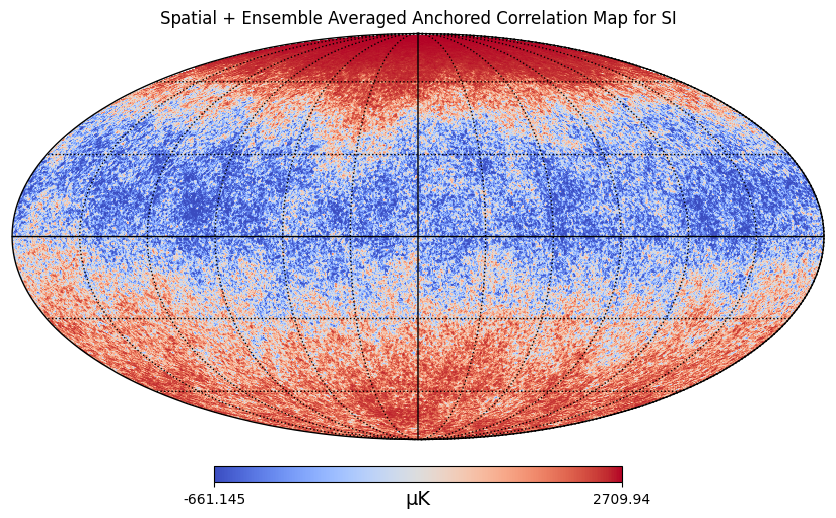

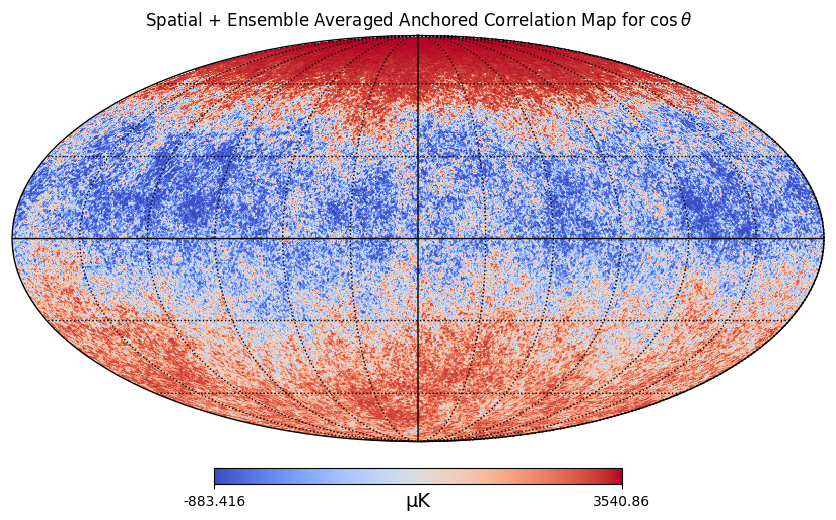

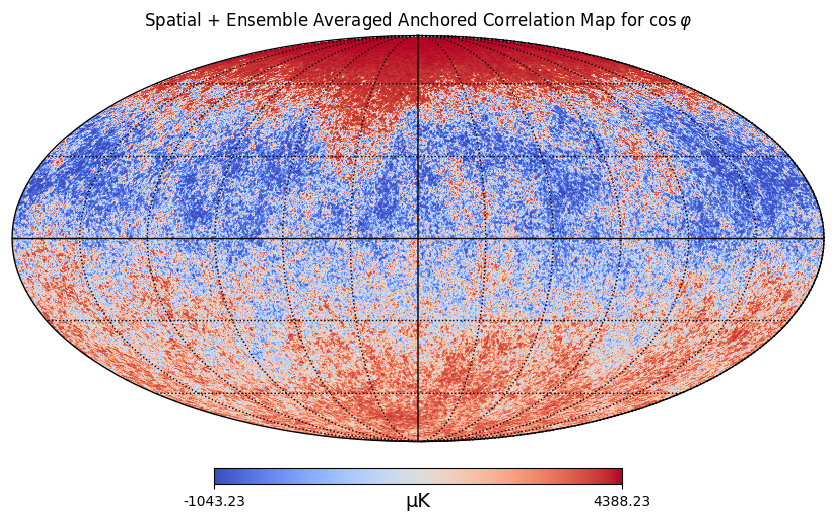

In [100]:
hp.mollview(Anchored_correlation_SI, title="Spatial + Ensemble Averaged Anchored Correlation Map for SI",norm="hist", cmap="coolwarm", unit="μK")
hp.graticule()
plt.show()

hp.mollview(Anchored_correlation_nSI5, title=r"Spatial + Ensemble Averaged Anchored Correlation Map for $\cos \theta$",norm="hist", cmap="coolwarm", unit="μK")
hp.graticule()
plt.show()

hp.mollview(Anchored_correlation_nSI6, title=r"Spatial + Ensemble Averaged Anchored Correlation Map for $\cos \varphi$",norm="hist", cmap="coolwarm", unit="μK")
hp.graticule()
plt.show()

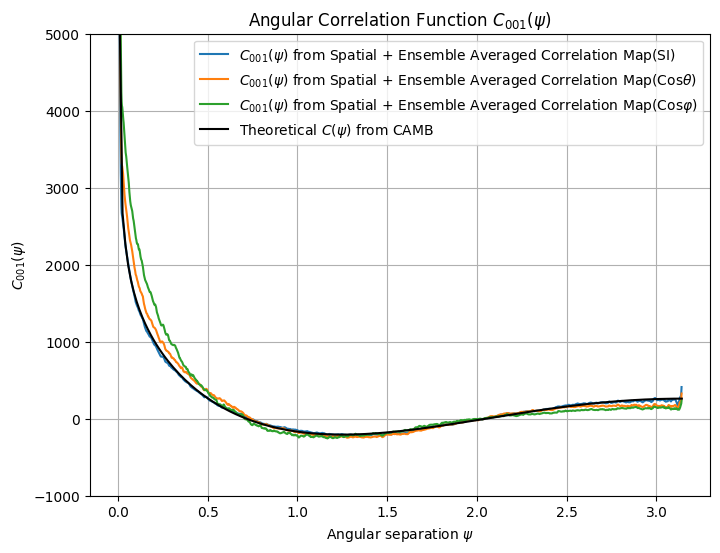

In [101]:
plt.figure(figsize=(8, 6))
plt.plot(psi_values_SI, C_001_SA_EA_SI, label=r'$C_{001}(\psi)$ from Spatial + Ensemble Averaged Correlation Map(SI)')
plt.plot(psi_values_nSI3, C_001_SA_EA_nSI5, label=r'$C_{001}(\psi)$ from Spatial + Ensemble Averaged Correlation Map(Cos$\theta$)')
plt.plot(psi_values_nSI4, C_001_SA_EA_nSI6, label=r'$C_{001}(\psi)$ from Spatial + Ensemble Averaged Correlation Map(Cos$\varphi$)')
plt.plot(psi, c_psi, color='black', label=r'Theoretical $C(\psi)$ from CAMB')
plt.xlabel(r'Angular separation $\psi$')
plt.ylabel(r'$C_{001}(\psi)$')
plt.title('Angular Correlation Function $C_{001}(\psi)$')
plt.legend()
plt.ylim(-1000, 5000)
plt.grid()
plt.show()

In [102]:
from scipy.interpolate import interp1d

# Interpolate c_psi as a function of psi
c_psi_interp = interp1d(psi, c_psi, kind='cubic', fill_value="extrapolate")

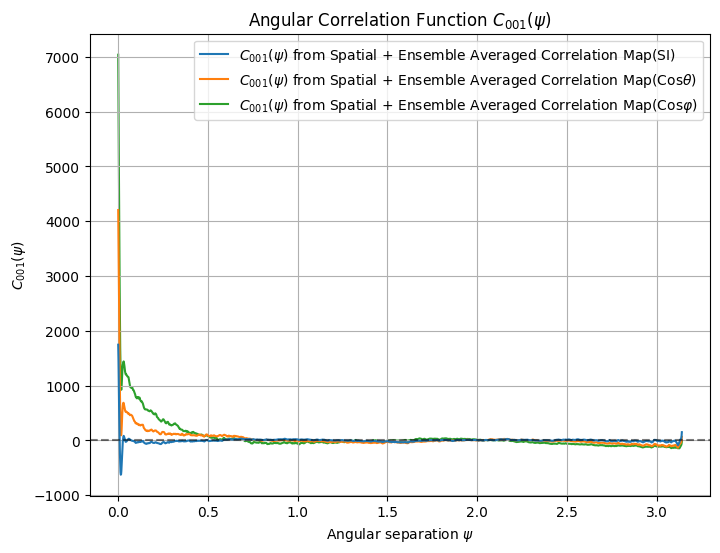

In [103]:
# plot the Difference between the C_001(psi) from maps - c_psi

plt.figure(figsize=(8, 6))
plt.plot(psi_values_SI, C_001_SA_EA_SI - c_psi_interp(psi_values_SI), label=r'$C_{001}(\psi)$ from Spatial + Ensemble Averaged Correlation Map(SI)', zorder =3)
plt.plot(psi_values_nSI3, C_001_SA_EA_nSI5 - c_psi_interp(psi_values_nSI3), label=r'$C_{001}(\psi)$ from Spatial + Ensemble Averaged Correlation Map(Cos$\theta$)', zorder =2)
plt.plot(psi_values_nSI4, C_001_SA_EA_nSI6 - c_psi_interp(psi_values_nSI4), label=r'$C_{001}(\psi)$ from Spatial + Ensemble Averaged Correlation Map(Cos$\varphi$)', zorder =1)
plt.axhline(0, color='black', linestyle='--', alpha = 0.5, zorder =4)
plt.xlabel(r'Angular separation $\psi$')
plt.ylabel(r'$C_{001}(\psi)$')
plt.title('Angular Correlation Function $C_{001}(\psi)$')
plt.legend()
plt.grid()
plt.show()

In [104]:
phi_values_SI, C_001_SAEA_phi_SI = get_C001_phi(Anchored_correlation_SI, n_phi = False)
phi_values_nSI3, C_001_SAEA_phi_nSI5 = get_C001_phi(Anchored_correlation_nSI5, n_phi = False)
phi_values_nSI4, C_001_SAEA_phi_nSI6 = get_C001_phi(Anchored_correlation_nSI6, n_phi = False)

Number of distinct phi values: 89474
Number of distinct phi values: 89474
Number of distinct phi values: 89474


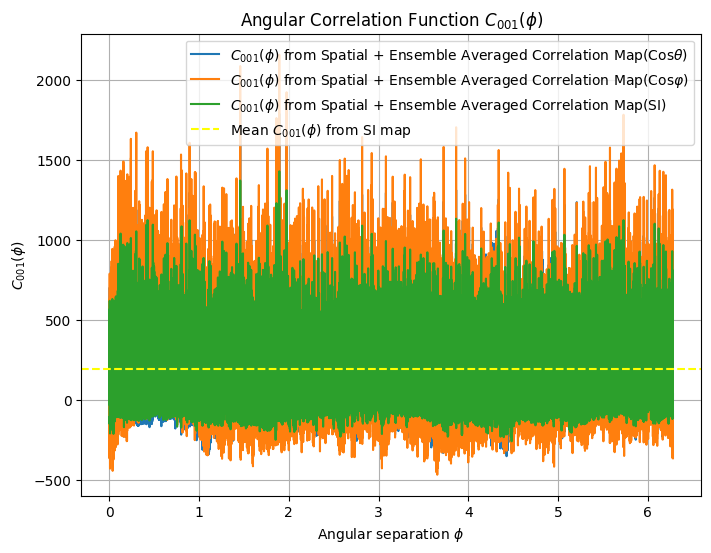

In [105]:
# plot Each of these C_001(phi) for SI and nSI maps

plt.figure(figsize=(8, 6))

plt.plot(phi_values_nSI3, C_001_SAEA_phi_nSI5, label=r'$C_{001}(\phi)$ from Spatial + Ensemble Averaged Correlation Map(Cos$\theta$)')
plt.plot(phi_values_nSI4, C_001_SAEA_phi_nSI6, label=r'$C_{001}(\phi)$ from Spatial + Ensemble Averaged Correlation Map(Cos$\varphi$)')
plt.plot(phi_values_SI, C_001_SAEA_phi_SI, label=r'$C_{001}(\phi)$ from Spatial + Ensemble Averaged Correlation Map(SI)')
plt.axhline(np.mean(C_001_SAEA_phi_SI), color='Yellow', linestyle='--', label=r'Mean $C_{001}(\phi)$ from SI map')
plt.xlabel(r'Angular separation $\phi$')
plt.ylabel(r'$C_{001}(\phi)$')
plt.title('Angular Correlation Function $C_{001}(\phi)$')
plt.legend()
plt.grid()
plt.show()

## Calculate c_phi for Cos $(2 \varphi )$